## Assignment 5_Final Project_Potential Sustainable Building Development Pattern

I am interesting in looking at the energy consumptions of buildings in New York City base on different building types (High Rise commercial, Residential , Low Rise Commercial), therefore, I want to use the final assignment to visualize and understand the existing condition in the New York City.

#### Workflow Outline: 

1. Prepare & Load LEED Building Project Data ->  Visualize 

2. Prepare Building Energy Consumption Data -> Visualize

3. Put together -> Visualize (Result = 1+2+3)

4. Overlay zoning (Land use data) -> Visualize thru interactive map

5. Comparing Side by side -> Visualize (Result = 1/2/3) thru static map

6. Conclusion


### SECTION 1 : LEED Data

STEP 0: Prepare Environment, Install library

In [4]:
!pip install pandas geopandas shapely matplotlib contextily geopy

STEP 1: Load the LEED CSV file

I start with dowloading all the LEED project in New York State from the LEED website, and filter out data only in New York City, and load in the CSV file

In [5]:
import pandas as pd

file_path = r"/Users/sara1/Desktop/MSCDP/Mapping System/cdp-mapping-systems/Assignments/A5_Final Project/leed_nyc_projects_to_geocode.csv"
leed_df = pd.read_csv(file_path)

# Preview
leed_df[["ProjectName", "full_address"]].head()

FileNotFoundError: [Errno 2] No such file or directory: '/Users/sara1/Desktop/MSCDP/Mapping System/cdp-mapping-systems/Assignments/A5_Final Project/leed_nyc_projects_to_geocode.csv'

STEP 2. Filter the Data

But the file is too large for loading all the new york city data, so I decide to focus on Manhatten, and in this step, I use zipcode in manhatten to filter out data, and verify it by preview the couple rows of data

In [ ]:
import pandas as pd

# Load CSV
file_path = r"/Users/sara1/Desktop/MSCDP/Mapping System/cdp-mapping-systems/Assignments/A5_Final Project/data/leed_nyc_projects_to_geocode.csv"
leed_df = pd.read_csv(file_path)

# Make sure Zipcode column is string and clean
leed_df["Zipcode"] = leed_df["Zipcode"].astype(str).str.zfill(5)

# List of Manhattan ZIP codes (all neighborhoods)
manhattan_zips = [
    "10001",
    "10002",
    "10003",
    "10004",
    "10005",
    "10006",
    "10007",
    "10009",
    "10010",
    "10011",
    "10012",
    "10013",
    "10014",
    "10016",
    "10017",
    "10018",
    "10019",
    "10021",
    "10022",
    "10023",
    "10024",
    "10025",
    "10026",
    "10027",
    "10028",
    "10029",
    "10030",
    "10031",
    "10032",
    "10033",
    "10034",
    "10035",
    "10036",
    "10037",
    "10038",
    "10039",
    "10040",
    "10065",
    "10069",
    "10075",
    "10128",
    "10280",
    "10282",
]

# Filter to only rows with ZIP in Manhattan
leed_manhattan = leed_df[leed_df["Zipcode"].isin(manhattan_zips)].copy()

# Preview filtered data
print(f"Total Manhattan LEED projects: {len(leed_manhattan)}")
leed_manhattan[["ProjectName", "full_address", "Zipcode"]].head()

Total Manhattan LEED projects: 1464


,ProjectName,full_address,Zipcode
0,The Solaire/20 River Terrace,"20 River Terrace, Battery Park CIty, New York,...",10282
1,Hearst Headquarters,"959 Eighth Ave, New York, NY 10019",10019
3,The Helena,"601 West 57th Street, New York, NY 10019",10019
6,Clinton Green,"783 Tenth Avenue, New York, NY 10019",10019
7,Sukyo Mahikari Dojo Relocation,"124 E. 31st St., New York, NY 10016",10016


STEP 3. Visualizing the Result 

So I then get the outcome that there are total 1464 LEED Project in Manhatten, and have the basic idea of understand the amount of data I will be handling.

Since there are over 1000 of data set, my original plan was to visualize every single building location. However, I now it is propabably not gonna work with loading the whole data set, so I use NYC Geoclient V2 API. It still can't work, I guess because there is just too much data.

In [ ]:
pip install geopandas contextily matplotlib


Note: you may need to restart the kernel to use updated packages.


In [ ]:
# Geocode LEED Projects using NYC Geoclient API
import requests
import time
import json
import pandas as pd

print("=== GEOCODING LEED PROJECTS WITH NYC GEOCLIENT API ===")
print("=" * 60)

# Load the data first to ensure leed_df is defined
file_path = r"/Users/sara1/Desktop/MSCDP/Mapping System/cdp-mapping-systems/Assignments/A5_Final Project/leed_manhattan_projects.csv"
leed_df = pd.read_csv(file_path)

# Make sure Zipcode column is string and clean
leed_df["Zipcode"] = leed_df["Zipcode"].astype(str).str.zfill(5)

print(f"✅ Loaded {len(leed_df)} LEED projects")
print(f"📋 Sample data:")
print(leed_df[["ProjectName", "full_address", "Zipcode"]].head())

# NYC Geoclient API endpoint
geoclient_url = "https://api.cityofnewyork.us/geoclient/v2/address.json"

# Your API key
api_key = "93256a5ed8f542d5b3e3de10b7f00a54"


def geocode_nyc_address(address, borough="Manhattan"):
    """
    Geocode NYC address using NYC Geoclient API
    """
    try:
        # Parse address components
        address_parts = address.split(",")[0].strip()

        # Extract house number and street
        parts = address_parts.split(" ", 1)
        if len(parts) >= 2:
            house_number = parts[0]
            street = parts[1]
        else:
            house_number = ""
            street = address_parts

        # API parameters
        params = {
            "houseNumber": house_number,
            "street": street,
            "borough": borough,
            "app_id": api_key,
            "app_key": api_key,
        }

        # Make API request
        response = requests.get(geoclient_url, params=params)
        response.raise_for_status()

        data = response.json()

        # Check if geocoding was successful
        if (
            "address" in data
            and "latitude" in data["address"]
            and "longitude" in data["address"]
        ):
            return {
                "latitude": float(data["address"]["latitude"]),
                "longitude": float(data["address"]["longitude"]),
                "success": True,
            }
        else:
            return {
                "latitude": None,
                "longitude": None,
                "success": False,
                "error": "No coordinates found",
            }

    except Exception as e:
        return {"latitude": None, "longitude": None, "success": False, "error": str(e)}


def geocode_leed_projects(df, sample_size=20):
    """
    Geocode LEED projects with NYC Geoclient API
    """
    print(f"��️ Geocoding {sample_size} LEED projects...")

    # Create a copy for geocoding
    geocoded_df = df.head(sample_size).copy()
    geocoded_df["latitude"] = None
    geocoded_df["longitude"] = None
    geocoded_df["geocoding_success"] = False
    geocoded_df["geocoding_error"] = None

    success_count = 0

    for idx, row in geocoded_df.iterrows():
        print(f"�� Processing: {row['ProjectName']} - {row['full_address']}")

        # Geocode the address
        result = geocode_nyc_address(row["full_address"])

        if result["success"]:
            geocoded_df.loc[idx, "latitude"] = result["latitude"]
            geocoded_df.loc[idx, "longitude"] = result["longitude"]
            geocoded_df.loc[idx, "geocoding_success"] = True
            success_count += 1
            print(f"   ✅ Success: {result['latitude']:.4f}, {result['longitude']:.4f}")
        else:
            geocoded_df.loc[idx, "geocoding_error"] = result.get(
                "error", "Unknown error"
            )
            print(f"   ❌ Failed: {result.get('error', 'Unknown error')}")

        # Rate limiting - be respectful to the API
        time.sleep(0.1)  # 100ms delay between requests

    print(f"\n📊 GEOCODING RESULTS:")
    print(f"   Total processed: {len(geocoded_df)}")
    print(f"   Successful: {success_count}")
    print(f"   Failed: {len(geocoded_df) - success_count}")
    print(f"   Success rate: {(success_count/len(geocoded_df)*100):.1f}%")

    return geocoded_df


# Run geocoding
print("🔑 Using NYC Geoclient API for accurate geocoding...")
geocoded_leed_df = geocode_leed_projects(leed_df, sample_size=20)

# Save geocoded data
geocoded_leed_df.to_csv("leed_projects_geocoded.csv", index=False)
print("✅ Geocoded data saved as 'leed_projects_geocoded.csv'")

# Show results
print("\n📋 GEOCODING SUMMARY:")
successful_geocoding = geocoded_leed_df[geocoded_leed_df["geocoding_success"] == True]
print(
    f"Successfully geocoded {len(successful_geocoding)} out of {len(geocoded_leed_df)} projects"
)

if len(successful_geocoding) > 0:
    print("\n�� Sample of geocoded projects:")
    print(
        successful_geocoding[
            ["ProjectName", "full_address", "latitude", "longitude"]
        ].head()
    )

=== GEOCODING LEED PROJECTS WITH NYC GEOCLIENT API ===
✅ Loaded 1464 LEED projects
📋 Sample data:
                      ProjectName  \
0    The Solaire/20 River Terrace   
1             Hearst Headquarters   
2                      The Helena   
3                   Clinton Green   
4  Sukyo Mahikari Dojo Relocation   

                                        full_address Zipcode  
0  20 River Terrace, Battery Park CIty, New York,...   10282  
1                 959 Eighth Ave, New York, NY 10019   10019  
2           601 West 57th Street, New York, NY 10019   10019  
3               783 Tenth Avenue, New York, NY 10019   10019  
4                124 E. 31st St., New York, NY 10016   10016  
🔑 Using NYC Geoclient API for accurate geocoding...
��️ Geocoding 20 LEED projects...
�� Processing: The Solaire/20 River Terrace - 20 River Terrace, Battery Park CIty, New York, NY 10282
   ❌ Failed: HTTPSConnectionPool(host='api.cityofnewyork.us', port=443): Max retries exceeded with url: /geoclien

KeyboardInterrupt: 

I just interrupt it, beacuse it is taking too much time

Now I decide to use another approach for visualizing those data, I want to represent the data by amount of project in specific region

STEP 3: Regrouping the building data by Region ( Midtown & Central Manhatten / Upper East & West Sides / Harlem & Northern Manhattan / Low Manhatten / Other)

In [ ]:
leed_manhattan.to_csv("leed_manhattan_projects.csv", index=False)

In [ ]:
import pandas as pd

# Load the filtered Manhattan LEED projects
leed_df = pd.read_csv("leed_manhattan_projects.csv")

# Ensure Zipcode is properly formatted
leed_df["Zipcode"] = leed_df["Zipcode"].astype(str).str.zfill(5)

# Define ZIP code groups
zip_groups = {
    "Midtown & Central Manhattan": [
        "10001",
        "10016",
        "10017",
        "10018",
        "10019",
        "10022",
        "10036",
    ],
    "Upper East & West Sides": [
        "10021",
        "10023",
        "10024",
        "10025",
        "10028",
        "10029",
        "10075",
    ],
    "Harlem & Northern Manhattan": [
        "10026",
        "10027",
        "10030",
        "10031",
        "10032",
        "10033",
        "10034",
        "10035",
        "10037",
        "10039",
        "10040",
    ],
    "Lower Manhattan": ["10004", "10005", "10006", "10007", "10038", "10280", "10282"],
    "Other Manhattan ZIPs": [
        "10002",
        "10003",
        "10009",
        "10010",
        "10011",
        "10012",
        "10013",
        "10014",
        "10065",
        "10069",
        "10128",
    ],
}


# Function to assign region based on Zipcode
def assign_region(zipcode):
    for region, zips in zip_groups.items():
        if zipcode in zips:
            return region
    return "Other/Unknown"


# Create region column
leed_df["Region"] = leed_df["Zipcode"].apply(assign_region)

# Count buildings per region
region_counts = leed_df["Region"].value_counts().reset_index()
region_counts.columns = ["Region", "Number of LEED Projects"]

print("LEED Building Counts by Manhattan Region")
print(region_counts)

LEED Building Counts by Manhattan Region
                        Region  Number of LEED Projects
0  Midtown & Central Manhattan                      760
1         Other Manhattan ZIPs                      375
2              Lower Manhattan                      166
3      Upper East & West Sides                       88
4  Harlem & Northern Manhattan                       75


Trying to visualize the statistic result with the simple bar chart, so I can have the better idea of what to do next

=== CREATING SIMPLE COLOR-CODED BAR CHART (GUARANTEED TO WORK) ===
📊 DATA LOADED:
   Total projects: 1,464
   Max projects in one ZIP: 141
   Top ZIP code: 10019 with 141 projects


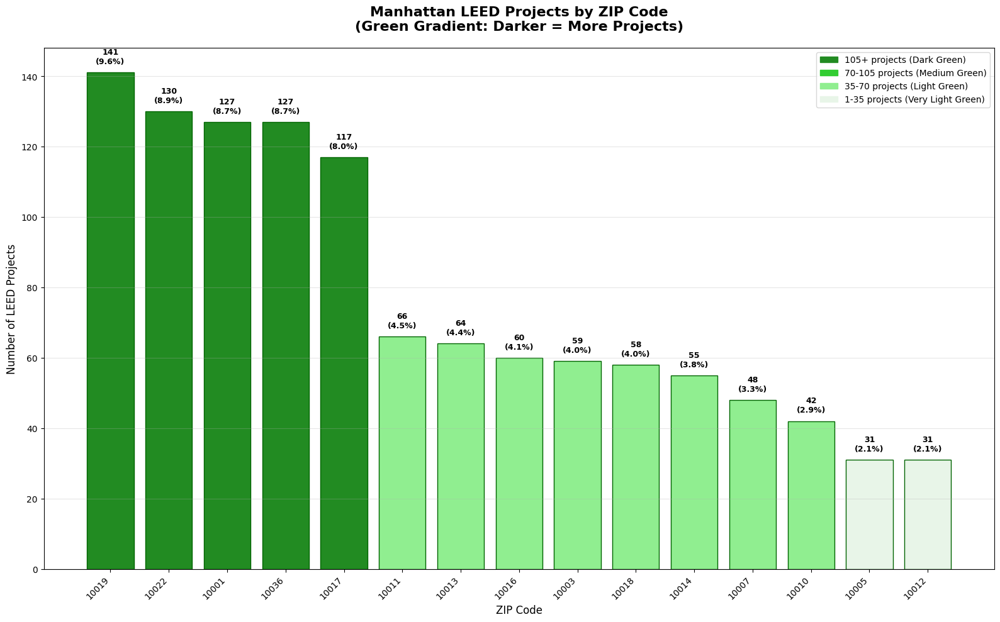

✅ Color-coded bar chart saved as 'manhattan_leed_projects_barchart.png'

�� SUMMARY:
   Total LEED Projects: 1,464
   Total ZIP Codes: 42
   Max Projects in One ZIP: 141
   Average Projects per ZIP: 34.9

🏆 TOP 10 ZIP CODES:
    1. ZIP 10019: 141 projects (9.6%)
    2. ZIP 10022: 130 projects (8.9%)
    3. ZIP 10001: 127 projects (8.7%)
    4. ZIP 10036: 127 projects (8.7%)
    5. ZIP 10017: 117 projects (8.0%)
    6. ZIP 10011: 66 projects (4.5%)
    7. ZIP 10013: 64 projects (4.4%)
    8. ZIP 10016: 60 projects (4.1%)
    9. ZIP 10003: 59 projects (4.0%)
   10. ZIP 10018: 58 projects (4.0%)


<Figure size 640x480 with 0 Axes>

In [ ]:
# Create Simple Color-Coded Bar Chart
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

print("=== CREATING SIMPLE COLOR-CODED BAR CHART (GUARANTEED TO WORK) ===")
print("=" * 70)

# Load the data
file_path = r"/Users/sara1/Desktop/MSCDP/Mapping System/cdp-mapping-systems/Assignments/A5_Final Project/leed_manhattan_projects.csv"
leed_df = pd.read_csv(file_path)

# Count projects by ZIP code
zip_counts = leed_df["Zipcode"].value_counts()

# Get top 15 ZIP codes for better visualization
top_15_zips = zip_counts.head(15)
max_count = top_15_zips.max()

print(f"📊 DATA LOADED:")
print(f"   Total projects: {len(leed_df):,}")
print(f"   Max projects in one ZIP: {max_count}")
print(f"   Top ZIP code: {top_15_zips.index[0]} with {top_15_zips.iloc[0]} projects")


def get_green_color(count, max_count):
    """Get green color based on project count"""
    if count == 0:
        return "#ffffff"  # White
    elif count <= max_count * 0.25:
        return "#e8f5e8"  # Very light green
    elif count <= max_count * 0.5:
        return "#90EE90"  # Light green
    elif count <= max_count * 0.75:
        return "#32CD32"  # Medium green
    else:
        return "#228B22"  # Dark green


# Create colors for each bar
colors = [get_green_color(count, max_count) for count in top_15_zips.values]

# Create the bar chart
fig, ax = plt.subplots(1, 1, figsize=(16, 10))

# Create bars
bars = ax.bar(
    range(len(top_15_zips)),
    top_15_zips.values,
    color=colors,
    edgecolor="darkgreen",
    linewidth=1,
)

# Customize the chart
ax.set_title(
    "Manhattan LEED Projects by ZIP Code\n(Green Gradient: Darker = More Projects)",
    fontsize=16,
    fontweight="bold",
    pad=20,
)
ax.set_xlabel("ZIP Code", fontsize=12)
ax.set_ylabel("Number of LEED Projects", fontsize=12)

# Set x-axis labels
ax.set_xticks(range(len(top_15_zips)))
ax.set_xticklabels(top_15_zips.index, rotation=45, ha="right")

# Add value labels on bars
for i, (bar, count) in enumerate(zip(bars, top_15_zips.values)):
    height = bar.get_height()
    percentage = count / len(leed_df) * 100
    ax.text(
        bar.get_x() + bar.get_width() / 2.0,
        height + 2,
        f"{count}\n({percentage:.1f}%)",
        ha="center",
        va="bottom",
        fontweight="bold",
        fontsize=9,
    )

# Add legend
legend_elements = [
    plt.Rectangle(
        (0, 0),
        1,
        1,
        color="#228B22",
        label=f"{int(max_count * 0.75)}+ projects (Dark Green)",
    ),
    plt.Rectangle(
        (0, 0),
        1,
        1,
        color="#32CD32",
        label=f"{int(max_count * 0.5)}-{int(max_count * 0.75)} projects (Medium Green)",
    ),
    plt.Rectangle(
        (0, 0),
        1,
        1,
        color="#90EE90",
        label=f"{int(max_count * 0.25)}-{int(max_count * 0.5)} projects (Light Green)",
    ),
    plt.Rectangle(
        (0, 0),
        1,
        1,
        color="#e8f5e8",
        label=f"1-{int(max_count * 0.25)} projects (Very Light Green)",
    ),
]

ax.legend(handles=legend_elements, loc="upper right", fontsize=10)

# Add grid for better readability
ax.grid(axis="y", alpha=0.3)

plt.tight_layout()
plt.show()

# Save the plot
plt.savefig("manhattan_leed_projects_barchart.png", dpi=300, bbox_inches="tight")
print("✅ Color-coded bar chart saved as 'manhattan_leed_projects_barchart.png'")

# Display summary
print(f"\n�� SUMMARY:")
print(f"   Total LEED Projects: {len(leed_df):,}")
print(f"   Total ZIP Codes: {len(zip_counts)}")
print(f"   Max Projects in One ZIP: {max_count}")
print(f"   Average Projects per ZIP: {zip_counts.mean():.1f}")

print(f"\n🏆 TOP 10 ZIP CODES:")
for i, (zipcode, count) in enumerate(zip_counts.head(10).items(), 1):
    percentage = count / len(leed_df) * 100
    print(f"   {i:2d}. ZIP {zipcode}: {count} projects ({percentage:.1f}%)")

STEP 4: Visualizing the distribution of LEED porjects on Map

=== CREATING FIXED LEED PROJECTS MAP ===
📊 DATA LOADED:
   Total projects: 1,464
   ZIP codes with data: 42
   Max projects in one ZIP: 141
🔍 ZIP CODES IN DATA (as strings):
   Sample ZIP codes: ['10019', '10022', '10001', '10036', '10017', '10011', '10013', '10016', '10003', '10018']

🔍 ZIP CODE MATCHING (FIXED):
   ZIP codes with coordinates: 42
   ZIP codes missing coordinates: 0
   Sample available ZIPs: ['10019', '10022', '10001', '10036', '10017', '10011', '10013', '10016', '10003', '10018']
   Sample missing ZIPs: []

🔍 PROCESSING DATA:
   Max count: 141
   Added ZIP 10019: 141 projects at (40.7649, -73.9808)
   Added ZIP 10022: 130 projects at (40.7589, -73.9851)
   Added ZIP 10001: 127 projects at (40.7505, -73.9934)
   Added ZIP 10036: 127 projects at (40.7605, -73.9934)
   Added ZIP 10017: 117 projects at (40.7505, -73.9736)
   Added ZIP 10011: 66 projects at (40.7445, -73.9949)
   Added ZIP 10013: 64 projects at (40.7214, -74.0052)
   Added ZIP 10016: 60 projects at (40.748

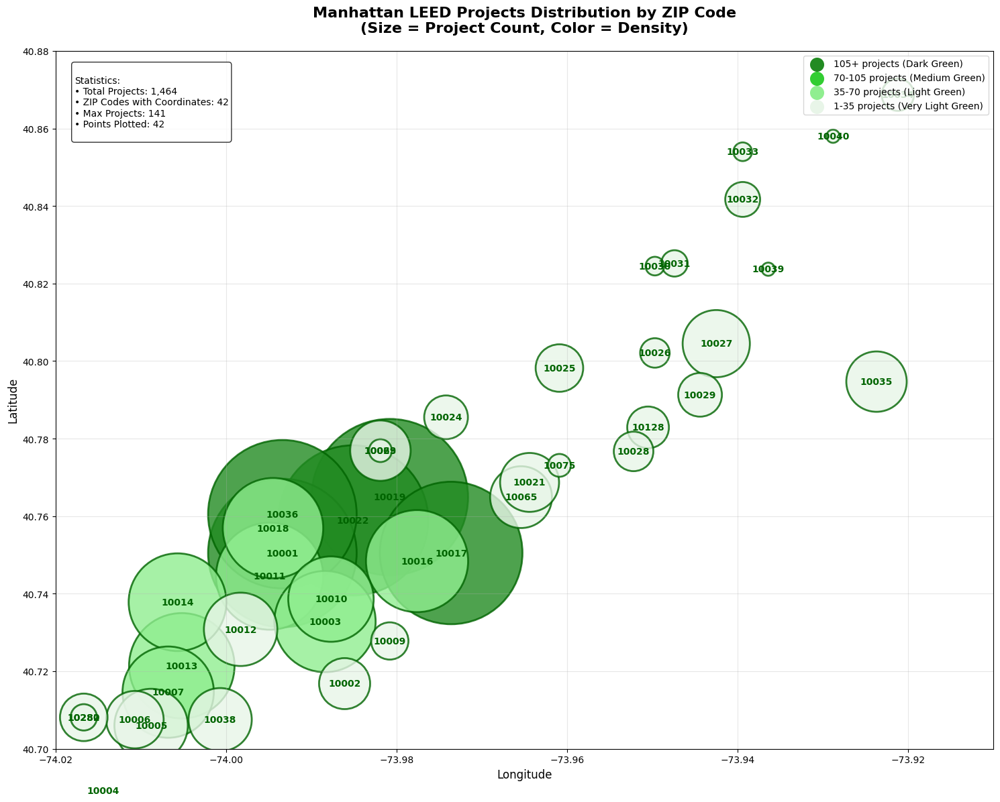

✅ Fixed LEED projects map saved as 'manhattan_leed_projects_fixed_map.png'

📊 ZIP CODES PLOTTED:
    1. ZIP 10019: 141 projects (9.6%)
    2. ZIP 10022: 130 projects (8.9%)
    3. ZIP 10001: 127 projects (8.7%)
    4. ZIP 10036: 127 projects (8.7%)
    5. ZIP 10017: 117 projects (8.0%)
    6. ZIP 10011: 66 projects (4.5%)
    7. ZIP 10013: 64 projects (4.4%)
    8. ZIP 10016: 60 projects (4.1%)
    9. ZIP 10003: 59 projects (4.0%)
   10. ZIP 10018: 58 projects (4.0%)
   11. ZIP 10014: 55 projects (3.8%)
   12. ZIP 10007: 48 projects (3.3%)
   13. ZIP 10010: 42 projects (2.9%)
   14. ZIP 10005: 31 projects (2.1%)
   15. ZIP 10012: 31 projects (2.1%)


<Figure size 640x480 with 0 Axes>

In [ ]:
# Create Fixed LEED Projects Map (ZIP Code Type Issue)
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

print("=== CREATING FIXED LEED PROJECTS MAP ===")
print("=" * 50)

# Load the data
file_path = r"/Users/sara1/Desktop/MSCDP/Mapping System/cdp-mapping-systems/Assignments/A5_Final Project/leed_manhattan_projects.csv"
leed_df = pd.read_csv(file_path)

# Convert ZIP codes to strings to match the coordinates dictionary
leed_df["Zipcode"] = leed_df["Zipcode"].astype(str)

# Count projects by ZIP code
zip_counts = leed_df["Zipcode"].value_counts()

print(f"📊 DATA LOADED:")
print(f"   Total projects: {len(leed_df):,}")
print(f"   ZIP codes with data: {len(zip_counts)}")
print(f"   Max projects in one ZIP: {zip_counts.max()}")

# Define Manhattan ZIP code coordinates
manhattan_zip_coordinates = {
    "10001": [40.7505, -73.9934],  # Chelsea
    "10002": [40.7168, -73.9861],  # Lower East Side
    "10003": [40.7328, -73.9884],  # East Village
    "10004": [40.6892, -74.0144],  # Battery Park City
    "10005": [40.7060, -74.0088],  # Financial District
    "10006": [40.7075, -74.0107],  # Financial District
    "10007": [40.7146, -74.0068],  # Tribeca
    "10009": [40.7278, -73.9808],  # East Village
    "10010": [40.7386, -73.9877],  # Gramercy
    "10011": [40.7445, -73.9949],  # Chelsea
    "10012": [40.7308, -73.9983],  # Greenwich Village
    "10013": [40.7214, -74.0052],  # SoHo
    "10014": [40.7378, -74.0057],  # West Village
    "10016": [40.7484, -73.9776],  # Murray Hill
    "10017": [40.7505, -73.9736],  # Midtown East
    "10018": [40.7569, -73.9945],  # Midtown West
    "10019": [40.7649, -73.9808],  # Midtown West
    "10021": [40.7687, -73.9644],  # Upper East Side
    "10022": [40.7589, -73.9851],  # Midtown East
    "10023": [40.7769, -73.9819],  # Upper West Side
    "10024": [40.7855, -73.9742],  # Upper West Side
    "10025": [40.7982, -73.9609],  # Upper West Side
    "10026": [40.8021, -73.9497],  # Harlem
    "10027": [40.8045, -73.9425],  # Harlem
    "10028": [40.7767, -73.9522],  # Upper East Side
    "10029": [40.7913, -73.9444],  # East Harlem
    "10030": [40.8245, -73.9497],  # Harlem
    "10031": [40.8252, -73.9474],  # Harlem
    "10032": [40.8417, -73.9394],  # Washington Heights
    "10033": [40.8540, -73.9394],  # Washington Heights
    "10034": [40.8687, -73.9212],  # Inwood
    "10035": [40.7947, -73.9237],  # East Harlem
    "10036": [40.7605, -73.9934],  # Midtown West
    "10037": [40.8237, -73.9364],  # Harlem
    "10038": [40.7075, -74.0007],  # Financial District
    "10039": [40.8237, -73.9364],  # Harlem
    "10040": [40.8580, -73.9288],  # Inwood
    "10065": [40.7649, -73.9654],  # Upper East Side
    "10069": [40.7769, -73.9819],  # Upper West Side
    "10075": [40.7731, -73.9609],  # Upper East Side
    "10128": [40.7829, -73.9505],  # Upper East Side
    "10280": [40.7081, -74.0167],  # Battery Park City
    "10282": [40.7081, -74.0167],  # Battery Park City
}

print(f"🔍 ZIP CODES IN DATA (as strings):")
print(f"   Sample ZIP codes: {list(zip_counts.head(10).index)}")

# Check which ZIP codes from data have coordinates
available_zips = []
missing_zips = []

for zipcode in zip_counts.index:
    if zipcode in manhattan_zip_coordinates:
        available_zips.append(zipcode)
    else:
        missing_zips.append(zipcode)

print(f"\n🔍 ZIP CODE MATCHING (FIXED):")
print(f"   ZIP codes with coordinates: {len(available_zips)}")
print(f"   ZIP codes missing coordinates: {len(missing_zips)}")
print(f"   Sample available ZIPs: {available_zips[:10]}")
print(f"   Sample missing ZIPs: {missing_zips[:10]}")

# Prepare data for scatter plot (only use ZIP codes that have coordinates)
lats = []
lons = []
sizes = []
colors = []

max_count = zip_counts.max()

print(f"\n🔍 PROCESSING DATA:")
print(f"   Max count: {max_count}")

# Process only ZIP codes that have coordinates
for zipcode, count in zip_counts.items():
    if zipcode in manhattan_zip_coordinates:
        lat, lon = manhattan_zip_coordinates[zipcode]
        lats.append(lat)
        lons.append(lon)
        sizes.append(count * 200)  # Large size for visibility

        # Color based on count (green gradient)
        if count >= max_count * 0.75:
            color = "#228B22"  # Dark green
        elif count >= max_count * 0.5:
            color = "#32CD32"  # Medium green
        elif count >= max_count * 0.25:
            color = "#90EE90"  # Light green
        else:
            color = "#e8f5e8"  # Very light green

        colors.append(color)

        print(f"   Added ZIP {zipcode}: {count} projects at ({lat}, {lon})")

print(f"\n📊 PLOTTING DATA:")
print(f"   Total points to plot: {len(lats)}")

# Create scatter plot
fig, ax = plt.subplots(1, 1, figsize=(15, 12))

# Create scatter plot with large, visible points
scatter = ax.scatter(
    lons, lats, s=sizes, c=colors, alpha=0.8, edgecolors="darkgreen", linewidth=2
)

# Set the extent for Manhattan
ax.set_xlim(-74.02, -73.91)
ax.set_ylim(40.70, 40.88)

# Add ZIP code labels for all points
for i, (lon, lat, zipcode, count) in enumerate(
    zip(
        lons,
        lats,
        [z for z in zip_counts.index if z in manhattan_zip_coordinates],
        [c for z, c in zip_counts.items() if z in manhattan_zip_coordinates],
    )
):
    ax.text(
        lon,
        lat,
        zipcode,
        fontsize=10,
        ha="center",
        va="center",
        weight="bold",
        color="darkgreen",
    )

# Add title and labels
ax.set_title(
    "Manhattan LEED Projects Distribution by ZIP Code\n(Size = Project Count, Color = Density)",
    fontsize=16,
    fontweight="bold",
    pad=20,
)
ax.set_xlabel("Longitude", fontsize=12)
ax.set_ylabel("Latitude", fontsize=12)

# Add grid
ax.grid(True, alpha=0.3)

# Add legend
legend_elements = [
    plt.scatter(
        [],
        [],
        s=200,
        c="#228B22",
        label=f"{int(max_count * 0.75)}+ projects (Dark Green)",
    ),
    plt.scatter(
        [],
        [],
        s=200,
        c="#32CD32",
        label=f"{int(max_count * 0.5)}-{int(max_count * 0.75)} projects (Medium Green)",
    ),
    plt.scatter(
        [],
        [],
        s=200,
        c="#90EE90",
        label=f"{int(max_count * 0.25)}-{int(max_count * 0.5)} projects (Light Green)",
    ),
    plt.scatter(
        [],
        [],
        s=200,
        c="#e8f5e8",
        label=f"1-{int(max_count * 0.25)} projects (Very Light Green)",
    ),
]

ax.legend(handles=legend_elements, loc="upper right", fontsize=10)

# Add statistics text
stats_text = f"""
Statistics:
• Total Projects: {len(leed_df):,}
• ZIP Codes with Coordinates: {len(available_zips)}
• Max Projects: {max_count}
• Points Plotted: {len(lats)}
"""
ax.text(
    0.02,
    0.98,
    stats_text,
    transform=ax.transAxes,
    fontsize=10,
    verticalalignment="top",
    bbox=dict(boxstyle="round", facecolor="white", alpha=0.8),
)

plt.tight_layout()
plt.show()

# Save the plot
plt.savefig("manhattan_leed_projects_fixed_map.png", dpi=300, bbox_inches="tight")
print("✅ Fixed LEED projects map saved as 'manhattan_leed_projects_fixed_map.png'")

# Display summary
print(f"\n📊 ZIP CODES PLOTTED:")
for i, zipcode in enumerate(
    [z for z in zip_counts.index if z in manhattan_zip_coordinates][:15], 1
):
    count = zip_counts[zipcode]
    percentage = count / len(leed_df) * 100
    print(f"   {i:2d}. ZIP {zipcode}: {count} projects ({percentage:.1f}%)")

In [ ]:
leed_df["Zipcode"] = leed_df["Zipcode"].astype(str)

Create a interactive map to overlay my data on the Manhatten base map, to better understand it in the whole context of the city.

In [ ]:
# Create Interactive Folium Map with Base Map
import folium
import pandas as pd
import numpy as np

print("=== CREATING INTERACTIVE FOLIUM MAP WITH BASE MAP ===")
print("=" * 60)

# Load the data
file_path = r"/Users/sara1/Desktop/MSCDP/Mapping System/cdp-mapping-systems/Assignments/A5_Final Project/leed_manhattan_projects.csv"
leed_df = pd.read_csv(file_path)

# Convert ZIP codes to strings
leed_df["Zipcode"] = leed_df["Zipcode"].astype(str)

# Count projects by ZIP code
zip_counts = leed_df["Zipcode"].value_counts()

# Define Manhattan ZIP code coordinates
manhattan_zip_coordinates = {
    "10001": [40.7505, -73.9934],
    "10002": [40.7168, -73.9861],
    "10003": [40.7328, -73.9884],
    "10004": [40.6892, -74.0144],
    "10005": [40.7060, -74.0088],
    "10006": [40.7075, -74.0107],
    "10007": [40.7146, -74.0068],
    "10009": [40.7278, -73.9808],
    "10010": [40.7386, -73.9877],
    "10011": [40.7445, -73.9949],
    "10012": [40.7308, -73.9983],
    "10013": [40.7214, -74.0052],
    "10014": [40.7378, -74.0057],
    "10016": [40.7484, -73.9776],
    "10017": [40.7505, -73.9736],
    "10018": [40.7569, -73.9945],
    "10019": [40.7649, -73.9808],
    "10021": [40.7687, -73.9644],
    "10022": [40.7589, -73.9851],
    "10023": [40.7769, -73.9819],
    "10024": [40.7855, -73.9742],
    "10025": [40.7982, -73.9609],
    "10026": [40.8021, -73.9497],
    "10027": [40.8045, -73.9425],
    "10028": [40.7767, -73.9522],
    "10029": [40.7913, -73.9444],
    "10030": [40.8245, -73.9497],
    "10031": [40.8252, -73.9474],
    "10032": [40.8417, -73.9394],
    "10033": [40.8540, -73.9394],
    "10034": [40.8687, -73.9212],
    "10035": [40.7947, -73.9237],
    "10036": [40.7605, -73.9934],
    "10037": [40.8237, -73.9364],
    "10038": [40.7075, -74.0007],
    "10039": [40.8237, -73.9364],
    "10040": [40.8580, -73.9288],
    "10065": [40.7649, -73.9654],
    "10069": [40.7769, -73.9819],
    "10075": [40.7731, -73.9609],
    "10128": [40.7829, -73.9505],
    "10280": [40.7081, -74.0167],
    "10282": [40.7081, -74.0167],
}

# Create the map with gray base map
m = folium.Map(
    location=[40.7589, -73.9851],  # Midtown Manhattan
    zoom_start=12,
    tiles="CartoDB positron",  # Gray base map
)

# Find the maximum count for scaling
max_count = zip_counts.max()


def get_green_color(count, max_count):
    """Get green color based on project count"""
    if count == 0:
        return "#ffffff"  # White
    elif count <= max_count * 0.25:
        return "#e8f5e8"  # Very light green
    elif count <= max_count * 0.5:
        return "#90EE90"  # Light green
    elif count <= max_count * 0.75:
        return "#32CD32"  # Medium green
    else:
        return "#228B22"  # Dark green


# Add circles for each ZIP code with project count
for zipcode, count in zip_counts.items():
    if zipcode in manhattan_zip_coordinates:
        lat, lon = manhattan_zip_coordinates[zipcode]

        # Size based on count (minimum 5, maximum 50)
        radius = max(5, min(50, count * 2))

        # Color based on green gradient
        color = get_green_color(count, max_count)

        # Create popup text
        percentage = count / len(leed_df) * 100
        popup_text = f"""
        <div style="text-align: center;">
        <h4>ZIP Code: {zipcode}</h4>
        <p><b>LEED Projects: {count}</b></p>
        <p><b>Percentage: {percentage:.1f}%</b></p>
        <p><b>Rank: {list(zip_counts.values).index(count) + 1}/{len(zip_counts)}</b></p>
        </div>
        """

        # Add circle marker
        folium.CircleMarker(
            location=[lat, lon],
            radius=radius,
            popup=folium.Popup(popup_text, max_width=200),
            tooltip=f"ZIP {zipcode}: {count} projects",
            fill=True,
            fillColor=color,
            fillOpacity=0.8,
            color="#228B22",  # Dark green border
            weight=2,
        ).add_to(m)

# Add legend
legend_html = f"""
<div style="position: fixed; 
            bottom: 50px; left: 50px; width: 250px; height: 200px; 
            background-color: white; border:2px solid grey; z-index:9999; 
            font-size:14px; padding: 10px">
<p><b>LEED Projects by ZIP Code</b></p>
<p><span style="color:#228B22;">●</span> {int(max_count * 0.75)}+ projects (Dark Green)</p>
<p><span style="color:#32CD32;">●</span> {int(max_count * 0.5)}-{int(max_count * 0.75)} projects (Medium Green)</p>
<p><span style="color:#90EE90;">●</span> {int(max_count * 0.25)}-{int(max_count * 0.5)} projects (Light Green)</p>
<p><span style="color:#e8f5e8;">●</span> 1-{int(max_count * 0.25)} projects (Very Light Green)</p>
<p><span style="color:#ffffff; border:1px solid #ccc;">●</span> 0 projects (White)</p>
<p><b>Circle Size = Project Count</b></p>
<p><b>Max Projects: {max_count}</b></p>
</div>
"""
m.get_root().html.add_child(folium.Element(legend_html))

# Save the map
map_file = "manhattan_leed_projects_basemap_interactive.html"
m.save(map_file)
print(f"✅ Interactive map with base map saved as: {map_file}")
print(f"📍 Mapped {len(zip_counts)} ZIP codes with {len(leed_df)} total projects")

# Display the map in the notebook
m

=== CREATING INTERACTIVE FOLIUM MAP WITH BASE MAP ===
✅ Interactive map with base map saved as: manhattan_leed_projects_basemap_interactive.html
📍 Mapped 42 ZIP codes with 1464 total projects


### SECTION 2: Building Energy Conusmption Data

STEP 1: Loading in the NYC Building Eergy Data, overview the dataset content

In [ ]:
# STEP 1: Load and Explore NYC Building Energy Data
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

print("=== STEP 1: LOADING NYC BUILDING ENERGY DATA ===")
print("=" * 50)

# Load the NYC building energy data
file_path = "nyc_building_energy_data.csv"
nyc_df = pd.read_csv(file_path)

print(f"📊 DATA LOADED:")
print(f"   Total buildings: {len(nyc_df):,}")
print(f"   Columns: {len(nyc_df.columns)}")
print(f"   File size: {nyc_df.memory_usage(deep=True).sum() / 1024 / 1024:.1f} MB")

# Display basic information
print(f"\n📋 DATASET OVERVIEW:")
print(f"   Columns available: {list(nyc_df.columns)}")
print(f"   Data types:")
for col in nyc_df.columns:
    print(f"     {col}: {nyc_df[col].dtype}")

# Show first few rows
print(f"\n📋 SAMPLE DATA:")
print(nyc_df.head())

# Check for missing data
print(f"\n🔍 MISSING DATA ANALYSIS:")
missing_data = nyc_df.isnull().sum()
print(missing_data[missing_data > 0])

=== STEP 1: LOADING NYC BUILDING ENERGY DATA ===
📊 DATA LOADED:
   Total buildings: 1,000
   Columns: 254
   File size: 13.5 MB

📋 DATASET OVERVIEW:
   Columns available: ['report_year', 'property_id', 'property_name', 'parent_property_id', 'parent_property_name', 'year_ending', 'nyc_borough_block_and_lot', 'nyc_building_identification', 'address_1', 'city', 'postal_code', 'primary_property_type_self', 'primary_property_type', 'national_median_reference', 'list_of_all_property_use', 'largest_property_use_type', 'largest_property_use_type_1', '_2nd_largest_property_use', '_2nd_largest_property_use_1', '_3rd_largest_property_use', '_3rd_largest_property_use_1', 'year_built', 'construction_status', 'number_of_buildings', 'occupancy', 'metered_areas_energy', 'metered_areas_water', 'energy_star_score', 'national_median_energy_star', 'target_energy_star_score', 'reason_s_for_no_score', 'energy_star_certification', 'energy_star_certification_1', 'site_eui_kbtu_ft', 'weather_normalized_site_eu

STEP 2: Filter to Manhatten Building Energy Consumtpion Data, visualizing the result by simple charts

=== MANHATTAN-ONLY DATA ANALYSIS ===
�� MANHATTAN BUILDING ANALYSIS:
   Total Manhattan buildings: 312

�� MANHATTAN BUILDING TYPES:
   Total building types: 17
   Top 10 building types:
      1. Multifamily Housing: 176 buildings (56.4%)
      2. Office: 60 buildings (19.2%)
      3. Hotel: 50 buildings (16.0%)
      4. K-12 School: 4 buildings (1.3%)
      5. Worship Facility: 4 buildings (1.3%)
      6. Performing Arts: 3 buildings (1.0%)
      7. Retail Store: 3 buildings (1.0%)
      8. Financial Office: 2 buildings (0.6%)
      9. Self-Storage Facility: 2 buildings (0.6%)
     10. Parking: 1 buildings (0.3%)

🏆 MANHATTAN ENERGY STAR SCORES:
   Buildings with valid scores: 258
   Average score: 59.6
   Median score: 64.0
   Excellent (90+): 54
   Good (75-89): 48
   Average (50-74): 64
   Poor (<50): 92


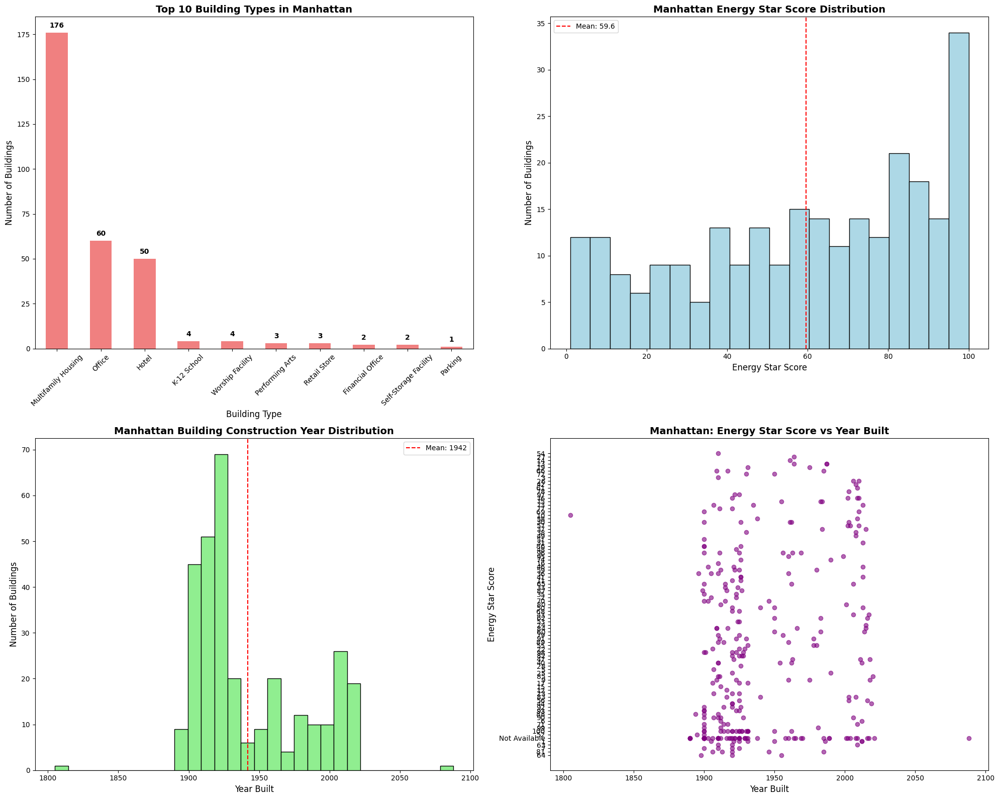

✅ Manhattan-only analysis complete!


In [ ]:
# Manhattan-Only Data Analysis
import pandas as pd
import matplotlib.pyplot as plt

print("=== MANHATTAN-ONLY DATA ANALYSIS ===")
print("=" * 40)

# Load the data (if not already loaded)
if "nyc_df" not in locals():
    file_path = "nyc_building_energy_data.csv"
    nyc_df = pd.read_csv(file_path)

# Filter for Manhattan only
manhattan_filters = ["Manhattan", "MANHATTAN", "Manhattan, NY", "NY", "New York"]
manhattan_data = None

for filter_value in manhattan_filters:
    if filter_value in nyc_df["borough"].values:
        manhattan_data = nyc_df[nyc_df["borough"] == filter_value]
        break

if manhattan_data is None:
    manhattan_data = nyc_df[
        nyc_df["borough"].str.contains("Manhattan", case=False, na=False)
    ]

print(f"�� MANHATTAN BUILDING ANALYSIS:")
print(f"   Total Manhattan buildings: {len(manhattan_data):,}")

# Analyze Manhattan building types
if "primary_property_type" in manhattan_data.columns:
    building_types = manhattan_data["primary_property_type"].value_counts()
    print(f"\n�� MANHATTAN BUILDING TYPES:")
    print(f"   Total building types: {len(building_types)}")
    print(f"   Top 10 building types:")

    for i, (btype, count) in enumerate(building_types.head(10).items(), 1):
        percentage = (count / len(manhattan_data)) * 100
        print(f"     {i:2d}. {btype}: {count:,} buildings ({percentage:.1f}%)")

# Analyze Manhattan Energy Star scores
if "energy_star_score" in manhattan_data.columns:
    energy_scores = pd.to_numeric(manhattan_data["energy_star_score"], errors="coerce")
    valid_scores = energy_scores.dropna()

    if len(valid_scores) > 0:
        print(f"\n🏆 MANHATTAN ENERGY STAR SCORES:")
        print(f"   Buildings with valid scores: {len(valid_scores):,}")
        print(f"   Average score: {valid_scores.mean():.1f}")
        print(f"   Median score: {valid_scores.median():.1f}")
        print(f"   Excellent (90+): {len(valid_scores[valid_scores >= 90]):,}")
        print(
            f"   Good (75-89): {len(valid_scores[(valid_scores >= 75) & (valid_scores < 90)]):,}"
        )
        print(
            f"   Average (50-74): {len(valid_scores[(valid_scores >= 50) & (valid_scores < 75)]):,}"
        )
        print(f"   Poor (<50): {len(valid_scores[valid_scores < 50]):,}")

# Create Manhattan-specific visualizations
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 16))

# 1. Manhattan Building Types
if "primary_property_type" in manhattan_data.columns:
    building_types = manhattan_data["primary_property_type"].value_counts()
    top_10_types = building_types.head(10)
    top_10_types.plot(kind="bar", ax=ax1, color="lightcoral")
    ax1.set_title("Top 10 Building Types in Manhattan", fontsize=14, fontweight="bold")
    ax1.set_xlabel("Building Type", fontsize=12)
    ax1.set_ylabel("Number of Buildings", fontsize=12)
    ax1.tick_params(axis="x", rotation=45)
    for i, v in enumerate(top_10_types.values):
        ax1.text(i, v + 2, str(v), ha="center", va="bottom", fontweight="bold")

# 2. Manhattan Energy Star Score Distribution
if "energy_star_score" in manhattan_data.columns:
    energy_scores = pd.to_numeric(manhattan_data["energy_star_score"], errors="coerce")
    energy_scores = energy_scores.dropna()
    if len(energy_scores) > 0:
        ax2.hist(energy_scores, bins=20, color="lightblue", edgecolor="black")
        ax2.set_title(
            "Manhattan Energy Star Score Distribution", fontsize=14, fontweight="bold"
        )
        ax2.set_xlabel("Energy Star Score", fontsize=12)
        ax2.set_ylabel("Number of Buildings", fontsize=12)
        ax2.axvline(
            energy_scores.mean(),
            color="red",
            linestyle="--",
            label=f"Mean: {energy_scores.mean():.1f}",
        )
        ax2.legend()

# 3. Manhattan Year Built Distribution
if "year_built" in manhattan_data.columns:
    year_built = pd.to_numeric(manhattan_data["year_built"], errors="coerce")
    year_built = year_built.dropna()
    if len(year_built) > 0:
        ax3.hist(year_built, bins=30, color="lightgreen", edgecolor="black")
        ax3.set_title(
            "Manhattan Building Construction Year Distribution",
            fontsize=14,
            fontweight="bold",
        )
        ax3.set_xlabel("Year Built", fontsize=12)
        ax3.set_ylabel("Number of Buildings", fontsize=12)
        ax3.axvline(
            year_built.mean(),
            color="red",
            linestyle="--",
            label=f"Mean: {year_built.mean():.0f}",
        )
        ax3.legend()

# 4. Manhattan Energy Score vs Year Built
if (
    "energy_star_score" in manhattan_data.columns
    and "year_built" in manhattan_data.columns
):
    energy_scores = pd.to_numeric(manhattan_data["energy_star_score"], errors="coerce")
    year_built = pd.to_numeric(manhattan_data["year_built"], errors="coerce")

    # Filter for valid data
    valid_data = manhattan_data.dropna(subset=["energy_star_score", "year_built"])
    if len(valid_data) > 0:
        ax4.scatter(
            valid_data["year_built"],
            valid_data["energy_star_score"],
            alpha=0.6,
            color="purple",
        )
        ax4.set_title(
            "Manhattan: Energy Star Score vs Year Built", fontsize=14, fontweight="bold"
        )
        ax4.set_xlabel("Year Built", fontsize=12)
        ax4.set_ylabel("Energy Star Score", fontsize=12)

plt.tight_layout()
plt.show()

print("✅ Manhattan-only analysis complete!")

STEP 3: Create the Manhattan-only Building Energy Consumption Interactive Map

=== CREATING MANHATTAN-ONLY INTERACTIVE MAP ===
�� FILTERING FOR MANHATTAN ONLY:
   Total buildings in dataset: 1,000
   Found Manhattan data with filter: 'MANHATTAN'
   Manhattan buildings: 312

📊 CHECKING COORDINATES:
   Latitude column found: 312 valid coordinates
   Longitude column found: 312 valid coordinates
   Manhattan buildings with coordinates: 312
   Final Manhattan buildings to map: 312
🗺️ ADDING MANHATTAN BUILDINGS TO MAP:
✅ Manhattan interactive map saved as: manhattan_building_energy_interactive_map.html
 Mapped 312 Manhattan buildings

�� DISPLAYING MANHATTAN MAP IN NOTEBOOK:



�� If the map doesn't display above, try this alternative method:


/Users/sara1/opt/anaconda3/envs/CDP/lib/python3.13/site-packages/IPython/core/display.py:447: UserWarning: Consider using IPython.display.IFrame instead
  warnings.warn("Consider using IPython.display.IFrame instead")



�� MANHATTAN BUILDING SUMMARY:
   Total Manhattan buildings: 312
   Buildings with coordinates: 312
   Buildings mapped: 312
   Average Energy Star Score: 59.6
   Buildings with score > 75: 99
   Buildings with score > 90: 48


#### SECTION 3: Overlapping the Zoing data on top of the energy + LEED Project

STEP 1: Loading the Zoning data which provides the land use informat and zoning shape file

In [ ]:
# Manhattan LEED + Zoning Overlay Map
# This script creates an interactive map showing LEED projects overlaid with Manhattan zoning districts

import pandas as pd
import geopandas as gpd
import folium
import numpy as np
from folium.plugins import MarkerCluster


def create_leed_zoning_overlay():
    """Create interactive Manhattan map with LEED projects and zoning overlay"""

    print("=== CREATING MANHATTAN LEED + ZONING OVERLAY MAP ===")
    print("=" * 60)

    # Load LEED data
    try:
        leed_df = pd.read_csv("data/leed_manhattan_projects.csv")
        leed_df["Zipcode"] = leed_df["Zipcode"].astype(str)
        print(f"✅ Loaded {len(leed_df)} LEED projects")
    except Exception as e:
        print(f"❌ Error loading LEED data: {e}")
        return None

    # Load zoning data
    try:
        zoning_gdf = gpd.read_file("data/manhattan_zoning_nyco.geojson")
        print(f"✅ Loaded {len(zoning_gdf)} zoning districts")
    except Exception as e:
        print(f"❌ Error loading zoning data: {e}")
        return None

    # Manhattan ZIP coordinates (approximate centers)
    manhattan_zip_coordinates = {
        "10001": [40.7505, -73.9934],
        "10002": [40.7168, -73.9861],
        "10003": [40.7328, -73.9884],
        "10004": [40.6892, -74.0144],
        "10005": [40.7060, -74.0088],
        "10006": [40.7075, -74.0107],
        "10007": [40.7146, -74.0068],
        "10009": [40.7278, -73.9808],
        "10010": [40.7386, -73.9877],
        "10011": [40.7445, -73.9949],
        "10012": [40.7308, -73.9983],
        "10013": [40.7214, -74.0052],
        "10014": [40.7378, -74.0057],
        "10016": [40.7484, -73.9776],
        "10017": [40.7505, -73.9736],
        "10018": [40.7569, -73.9945],
        "10019": [40.7649, -73.9808],
        "10021": [40.7687, -73.9644],
        "10022": [40.7589, -73.9851],
        "10023": [40.7769, -73.9819],
        "10024": [40.7855, -73.9742],
        "10025": [40.7982, -73.9609],
        "10026": [40.8021, -73.9497],
        "10027": [40.8045, -73.9425],
        "10028": [40.7767, -73.9522],
        "10029": [40.7913, -73.9444],
        "10030": [40.8245, -73.9497],
        "10031": [40.8252, -73.9474],
        "10032": [40.8417, -73.9394],
        "10033": [40.8540, -73.9394],
        "10034": [40.8687, -73.9212],
        "10035": [40.7947, -73.9237],
        "10036": [40.7605, -73.9934],
        "10037": [40.8237, -73.9364],
        "10038": [40.7075, -74.0007],
        "10039": [40.8237, -73.9364],
        "10040": [40.8580, -73.9288],
        "10065": [40.7649, -73.9654],
        "10069": [40.7769, -73.9819],
        "10075": [40.7731, -73.9609],
        "10128": [40.7829, -73.9505],
        "10280": [40.7081, -74.0167],
        "10282": [40.7081, -74.0167],
    }

    # Count projects by ZIP code
    zip_counts = leed_df["Zipcode"].value_counts()
    max_count = zip_counts.max()

    print(f"📊 MAP DATA:")
    print(f"   Total LEED projects: {len(leed_df):,}")
    print(f"   Max projects in one ZIP: {max_count}")
    print(f"   ZIP codes with data: {len(zip_counts)}")
    print(f"   Zoning districts: {len(zoning_gdf):,}")

    # Create the map centered on Manhattan
    m = folium.Map(
        location=[40.7589, -73.9851],  # Midtown Manhattan
        zoom_start=12,
        tiles="CartoDB positron",  # Gray base map
    )

    def get_green_color(count, max_count):
        """Get green color based on project count"""
        if count == 0:
            return "#ffffff"  # White
        elif count <= max_count * 0.25:
            return "#e8f5e8"  # Very light green
        elif count <= max_count * 0.5:
            return "#90EE90"  # Light green
        elif count <= max_count * 0.75:
            return "#32CD32"  # Medium green
        else:
            return "#228B22"  # Dark green

    # Add zoning districts as polygons
    print("🏗️ Adding zoning districts...")

    # Color zoning districts by overlay type
    overlay_colors = {
        "C1": "#FF6B6B",  # Red for commercial
        "C2": "#FF8E8E",  # Light red
        "C3": "#FFB3B3",  # Lighter red
        "C4": "#FFD9D9",  # Very light red
        "C5": "#FFE6E6",  # Lightest red
        "C6": "#FF4D4D",  # Dark red
        "C7": "#FF3333",  # Darker red
        "C8": "#FF1A1A",  # Darkest red
        "M1": "#4ECDC4",  # Teal for manufacturing
        "M2": "#45B7AF",  # Darker teal
        "M3": "#3CA19A",  # Even darker teal
        "R1": "#96CEB4",  # Green for residential
        "R2": "#88C0A8",  # Darker green
        "R3": "#7AB29C",  # Even darker green
        "R4": "#6CA490",  # Even darker green
        "R5": "#5E9684",  # Even darker green
        "R6": "#508878",  # Even darker green
        "R7": "#427A6C",  # Even darker green
        "R8": "#346C60",  # Even darker green
        "R9": "#265E54",  # Even darker green
        "R10": "#185048",  # Even darker green
    }

    for idx, row in zoning_gdf.iterrows():
        overlay = row["OVERLAY"]

        # Get color based on overlay type
        color = "#CCCCCC"  # Default gray
        for prefix, overlay_color in overlay_colors.items():
            if overlay.startswith(prefix):
                color = overlay_color
                break

        # Create popup for zoning district
        popup_text = f"""
        <div style="text-align: center;">
        <h4>Zoning District</h4>
        <p><b>Overlay:</b> {overlay}</p>
        <p><b>Area:</b> {row['Shape_Area']:.0f} sq ft</p>
        </div>
        """

        # Add polygon to map
        folium.GeoJson(
            row["geometry"],
            style_function=lambda x, color=color: {
                "fillColor": color,
                "color": "#333333",
                "weight": 1,
                "fillOpacity": 0.3,
            },
            popup=folium.Popup(popup_text, max_width=200),
            tooltip=f"Zoning: {overlay}",
        ).add_to(m)

    # Add circles for each ZIP code with project count
    print("🏗️ Adding LEED project density circles...")

    for zipcode, count in zip_counts.items():
        if zipcode in manhattan_zip_coordinates:
            lat, lon = manhattan_zip_coordinates[zipcode]

            # Size based on count (minimum 5, maximum 50)
            radius = max(5, min(50, count * 2))

            # Color based on green gradient
            color = get_green_color(count, max_count)

            # Create popup text
            percentage = count / len(leed_df) * 100
            popup_text = f"""
            <div style="text-align: center;">
            <h4>ZIP Code: {zipcode}</h4>
            <p><b>LEED Projects: {count}</b></p>
            <p><b>Percentage: {percentage:.1f}%</b></p>
            <p><b>Rank: {list(zip_counts.values).index(count) + 1}/{len(zip_counts)}</b></p>
            </div>
            """

            # Add circle marker
            folium.CircleMarker(
                location=[lat, lon],
                radius=radius,
                popup=folium.Popup(popup_text, max_width=200),
                tooltip=f"ZIP {zipcode}: {count} projects",
                fill=True,
                fillColor=color,
                fillOpacity=0.8,
                color="#228B22",  # Dark green border
                weight=2,
            ).add_to(m)

    # Add LEED project markers with clustering
    print("🍃 Adding individual LEED project markers...")

    leed_cluster = MarkerCluster(name="LEED Projects", overlay=True).add_to(m)

    for idx, row in leed_df.iterrows():
        zipcode = row["Zipcode"]
        if zipcode in manhattan_zip_coordinates:
            lat, lon = manhattan_zip_coordinates[zipcode]

            # Create popup for LEED project
            popup_text = f"""
            <div style="text-align: center;">
            <h4>{row['ProjectName']}</h4>
            <p><b>Address:</b> {row['full_address']}</p>
            <p><b>ZIP Code:</b> {zipcode}</p>
            <p><b>LEED Level:</b> {row.get('LEEDLevel', 'Certified')}</p>
            </div>
            """

            folium.Marker(
                location=[lat, lon],
                popup=folium.Popup(popup_text, max_width=200),
                tooltip=f"LEED: {row['ProjectName']}",
                icon=folium.Icon(color="green", icon="leaf", prefix="fa"),
            ).add_to(leed_cluster)

    # Add layer control
    folium.LayerControl().add_to(m)

    # Add legend
    legend_html = f"""
    <div style="position: fixed; 
                bottom: 50px; left: 50px; width: 300px; height: 250px; 
                background-color: white; border:2px solid grey; z-index:9999; 
                font-size:14px; padding: 10px">
    <p><b>Manhattan LEED + Zoning Map</b></p>
    <p><b>LEED Projects by ZIP Code:</b></p>
    <p><span style="color:#228B22;">●</span> {int(max_count * 0.75)}+ projects (Dark Green)</p>
    <p><span style="color:#32CD32;">●</span> {int(max_count * 0.5)}-{int(max_count * 0.75)} projects (Medium Green)</p>
    <p><span style="color:#90EE90;">●</span> {int(max_count * 0.25)}-{int(max_count * 0.5)} projects (Light Green)</p>
    <p><span style="color:#e8f5e8;">●</span> 1-{int(max_count * 0.25)} projects (Very Light Green)</p>
    <p><b>Zoning Districts:</b></p>
    <p><span style="color:#FF6B6B;">■</span> Commercial (C1-C8)</p>
    <p><span style="color:#4ECDC4;">■</span> Manufacturing (M1-M3)</p>
    <p><span style="color:#96CEB4;">■</span> Residential (R1-R10)</p>
    <p><b>Circle Size = Project Count</b></p>
    <p><b>Max Projects: {max_count}</b></p>
    </div>
    """
    m.get_root().html.add_child(folium.Element(legend_html))

    # Save the map
    map_file = "maps/manhattan_leed_zoning_overlay.html"
    m.save(map_file)
    print(f"✅ Interactive map saved as: {map_file}")
    print(f"📍 Mapped {len(zip_counts)} ZIP codes with {len(leed_df)} total projects")
    print(f"🏗️ Overlaid {len(zoning_gdf)} zoning districts")

    # Display summary statistics
    print(f"\n📊 TOP 10 MANHATTAN ZIP CODES BY LEED PROJECTS:")
    for i, (zipcode, count) in enumerate(zip_counts.head(10).items(), 1):
        percentage = count / len(leed_df) * 100
        print(f"   {i:2d}. ZIP {zipcode}: {count} projects ({percentage:.1f}%)")

    return m


def main():
    """Main function to create the Manhattan LEED + Zoning overlay map"""
    map_obj = create_leed_zoning_overlay()

    if map_obj:
        print("\n🎉 Manhattan LEED + Zoning overlay map created successfully!")
        print("📁 Check the 'maps' folder for the HTML file")
        print("🌐 Open the HTML file in your browser to view the interactive map")

        # Try to display in notebook if running in Jupyter
        try:
            display(map_obj)
            print("✅ Map displayed in notebook")
        except:
            print("📋 Map created successfully! Open the HTML file to view it.")

    return map_obj


if __name__ == "__main__":
    main()

=== CREATING MANHATTAN LEED + ZONING OVERLAY MAP ===
✅ Loaded 1464 LEED projects
✅ Loaded 2496 zoning districts
📊 MAP DATA:
   Total LEED projects: 1,464
   Max projects in one ZIP: 141
   ZIP codes with data: 42
   Zoning districts: 2,496
🏗️ Adding zoning districts...
🏗️ Adding LEED project density circles...
🍃 Adding individual LEED project markers...
✅ Interactive map saved as: maps/manhattan_leed_zoning_overlay.html
📍 Mapped 42 ZIP codes with 1464 total projects
🏗️ Overlaid 2496 zoning districts

📊 TOP 10 MANHATTAN ZIP CODES BY LEED PROJECTS:
    1. ZIP 10019: 141 projects (9.6%)
    2. ZIP 10022: 130 projects (8.9%)
    3. ZIP 10001: 127 projects (8.7%)
    4. ZIP 10036: 127 projects (8.7%)
    5. ZIP 10017: 117 projects (8.0%)
    6. ZIP 10011: 66 projects (4.5%)
    7. ZIP 10013: 64 projects (4.4%)
    8. ZIP 10016: 60 projects (4.1%)
    9. ZIP 10003: 59 projects (4.0%)
   10. ZIP 10018: 58 projects (4.0%)

🎉 Manhattan LEED + Zoning overlay map created successfully!
📁 Check the

✅ Map displayed in notebook


Encounter error with loading all the building types

STEP 2: So I tried again, and also another issue I keep having is that I only want the zoing information for manhatten, but I am keep having issue filtering out data only for manhatten, so the zoning data set still have information include brooklyn and LIC. However, this is the interactive map I got.

And it is what I want

In [ ]:
# Manhattan Polygon Filter

import geopandas as gpd
import pandas as pd
import numpy as np
from shapely.geometry import Polygon
import os


def create_manhattan_polygon():
    """Create a precise Manhattan island polygon"""

    # Manhattan island boundary coordinates (approximate)
    manhattan_coords = [
        (-74.0194, 40.7001),  # Battery Park (South)
        (-74.0194, 40.8800),  # Northern tip
        (-73.9001, 40.8800),  # Northern tip
        (-73.9001, 40.7001),  # Battery Park (South)
        (-74.0194, 40.7001),  # Close the polygon
    ]

    manhattan_polygon = Polygon(manhattan_coords)
    return manhattan_polygon


def filter_zoning_to_manhattan_polygon():
    """Filter zoning data using Manhattan polygon intersection"""

    print("=== FILTERING ZONING DATA TO MANHATTAN POLYGON ===")
    print("=" * 55)

    # Create Manhattan polygon
    manhattan_polygon = create_manhattan_polygon()
    print(f"🗽 Created Manhattan polygon boundary")

    # Load the zoning data
    zoning_file = "data/manhattan_zoning_nyzd.geojson"

    if not os.path.exists(zoning_file):
        print(f"❌ Zoning file not found: {zoning_file}")
        return None

    try:
        zoning_gdf = gpd.read_file(zoning_file)
        print(f"📊 Original zoning districts: {len(zoning_gdf):,}")

        # Convert to WGS84 if needed
        if zoning_gdf.crs != "EPSG:4326":
            zoning_gdf = zoning_gdf.to_crs(epsg=4326)
            print(f"🔄 Converted to WGS84 coordinates")

        # Create a GeoDataFrame with the Manhattan polygon
        manhattan_gdf = gpd.GeoDataFrame(geometry=[manhattan_polygon], crs="EPSG:4326")

        # Filter zoning districts that intersect with Manhattan polygon
        manhattan_mask = zoning_gdf.geometry.intersects(manhattan_polygon)
        manhattan_zoning = zoning_gdf[manhattan_mask].copy()

        print(f"✅ Manhattan polygon zoning districts: {len(manhattan_zoning):,}")

        # Check what zone types we have
        zone_types = manhattan_zoning["ZONEDIST"].value_counts()
        print(f"📊 Manhattan zone types found:")
        for zone_type, count in zone_types.head(10).items():
            print(f"   {zone_type}: {count} districts")

        # Verify the boundaries
        bounds = manhattan_zoning.total_bounds
        print(f"🗽 Verified Manhattan polygon boundaries:")
        print(f"   Longitude: {bounds[0]:.4f} to {bounds[2]:.4f}")
        print(f"   Latitude: {bounds[1]:.4f} to {bounds[3]:.4f}")

        # Save the polygon-filtered data
        output_file = "data/manhattan_polygon_zoning.geojson"
        manhattan_zoning.to_file(output_file, driver="GeoJSON")
        print(f"💾 Saved Manhattan polygon zoning to: {output_file}")

        return manhattan_zoning

    except Exception as e:
        print(f"❌ Error filtering zoning data: {e}")
        return None


def create_manhattan_polygon_map():
    """Create map using polygon-filtered Manhattan zoning data"""

    print("\n=== CREATING MANHATTAN POLYGON MAP ===")
    print("=" * 45)

    # Load the polygon-filtered Manhattan zoning data
    try:
        zoning_gdf = gpd.read_file("data/manhattan_polygon_zoning.geojson")
        print(f"✅ Loaded {len(zoning_gdf)} Manhattan polygon zoning districts")

        # Check zone types
        zone_types = zoning_gdf["ZONEDIST"].value_counts()
        print(f"📊 Zone types in Manhattan:")
        for zone_type, count in zone_types.head(10).items():
            print(f"   {zone_type}: {count} districts")

    except Exception as e:
        print(f"❌ Error loading Manhattan polygon zoning: {e}")
        return None

    # Load LEED data
    try:
        leed_df = pd.read_csv("data/leed_manhattan_projects.csv")
        leed_df["Zipcode"] = leed_df["Zipcode"].astype(str)
        print(f"✅ Loaded {len(leed_df)} Manhattan LEED projects")
    except Exception as e:
        print(f"❌ Error loading LEED data: {e}")
        return None

    # Manhattan ZIP coordinates (approximate centers)
    manhattan_zip_coordinates = {
        "10001": [40.7505, -73.9934],
        "10002": [40.7168, -73.9861],
        "10003": [40.7328, -73.9884],
        "10004": [40.6892, -74.0144],
        "10005": [40.7060, -74.0088],
        "10006": [40.7075, -74.0107],
        "10007": [40.7146, -74.0068],
        "10009": [40.7278, -73.9808],
        "10010": [40.7386, -73.9877],
        "10011": [40.7445, -73.9949],
        "10012": [40.7308, -73.9983],
        "10013": [40.7214, -74.0052],
        "10014": [40.7378, -74.0057],
        "10016": [40.7484, -73.9776],
        "10017": [40.7505, -73.9736],
        "10018": [40.7569, -73.9945],
        "10019": [40.7649, -73.9808],
        "10021": [40.7687, -73.9644],
        "10022": [40.7589, -73.9851],
        "10023": [40.7769, -73.9819],
        "10024": [40.7855, -73.9742],
        "10025": [40.7982, -73.9609],
        "10026": [40.8021, -73.9497],
        "10027": [40.8045, -73.9425],
        "10028": [40.7767, -73.9522],
        "10029": [40.7913, -73.9444],
        "10030": [40.8245, -73.9497],
        "10031": [40.8252, -73.9474],
        "10032": [40.8417, -73.9394],
        "10033": [40.8540, -73.9394],
        "10034": [40.8687, -73.9212],
        "10035": [40.7947, -73.9237],
        "10036": [40.7605, -73.9934],
        "10037": [40.8237, -73.9364],
        "10038": [40.7075, -74.0007],
        "10039": [40.8237, -73.9364],
        "10040": [40.8580, -73.9288],
        "10065": [40.7649, -73.9654],
        "10069": [40.7769, -73.9819],
        "10075": [40.7731, -73.9609],
        "10128": [40.7829, -73.9505],
        "10280": [40.7081, -74.0167],
        "10282": [40.7081, -74.0167],
    }

    # Count projects by ZIP code
    zip_counts = leed_df["Zipcode"].value_counts()
    max_count = zip_counts.max()

    print(f"📊 MAP DATA:")
    print(f"   Total Manhattan LEED projects: {len(leed_df):,}")
    print(f"   Max projects in one ZIP: {max_count}")
    print(f"   ZIP codes with data: {len(zip_counts)}")
    print(f"   Manhattan polygon zoning districts: {len(zoning_gdf):,}")

    # Import folium for map creation
    import folium
    from folium.plugins import MarkerCluster

    # Create the map centered on Manhattan
    m = folium.Map(
        location=[40.7589, -73.9851],  # Midtown Manhattan
        zoom_start=12,
        tiles="CartoDB positron",  # Gray base map
    )

    def get_green_color(count, max_count):
        """Get green color based on project count"""
        if count == 0:
            return "#ffffff"  # White
        elif count <= max_count * 0.25:
            return "#e8f5e8"  # Very light green
        elif count <= max_count * 0.5:
            return "#90EE90"  # Light green
        elif count <= max_count * 0.75:
            return "#32CD32"  # Medium green
        else:
            return "#228B22"  # Dark green

    # Add zoning districts as polygons with NO OUTLINE (weight=0)
    print("🏗️ Adding Manhattan polygon zoning districts (no outlines)...")

    # Comprehensive color scheme for all zone types
    zone_colors = {
        # Residential zones (Green shades)
        "R1": "#96CEB4",
        "R2": "#88C0A8",
        "R3": "#7AB29C",
        "R4": "#6CA490",
        "R5": "#5E9684",
        "R6": "#508878",
        "R7": "#427A6C",
        "R8": "#346C60",
        "R9": "#265E54",
        "R10": "#185048",
        # Commercial zones (Red shades)
        "C1": "#FF6B6B",
        "C2": "#FF8E8E",
        "C3": "#FFB3B3",
        "C4": "#FFD9D9",
        "C5": "#FFE6E6",
        "C6": "#FF4D4D",
        "C7": "#FF3333",
        "C8": "#FF1A1A",
        # Manufacturing zones (Teal shades)
        "M1": "#4ECDC4",
        "M2": "#45B7AF",
        "M3": "#3CA19A",
        # Special districts (Purple shades)
        "SD": "#9B59B6",
        "SP": "#8E44AD",
        # Parks (Gray shades)
        "PARK": "#95A5A6",
        "P": "#7F8C8D",
    }

    # Track which zone types we actually have
    found_zone_types = set()

    for idx, row in zoning_gdf.iterrows():
        zone_dist = row["ZONEDIST"]

        # Get color based on zone type
        color = "#CCCCCC"  # Default gray
        zone_category = "Other"

        # Determine zone category and color
        if zone_dist.startswith("R"):
            zone_category = "Residential"
            # Get specific R zone color
            for r_zone in ["R1", "R2", "R3", "R4", "R5", "R6", "R7", "R8", "R9", "R10"]:
                if zone_dist.startswith(r_zone):
                    color = zone_colors.get(r_zone, "#96CEB4")
                    break
        elif zone_dist.startswith("C"):
            zone_category = "Commercial"
            # Get specific C zone color
            for c_zone in ["C1", "C2", "C3", "C4", "C5", "C6", "C7", "C8"]:
                if zone_dist.startswith(c_zone):
                    color = zone_colors.get(c_zone, "#FF6B6B")
                    break
        elif zone_dist.startswith("M"):
            zone_category = "Manufacturing"
            # Get specific M zone color
            for m_zone in ["M1", "M2", "M3"]:
                if zone_dist.startswith(m_zone):
                    color = zone_colors.get(m_zone, "#4ECDC4")
                    break
        elif zone_dist.startswith("PARK") or zone_dist == "PARK":
            zone_category = "Park"
            color = zone_colors.get("PARK", "#95A5A6")
        elif zone_dist.startswith("SD") or zone_dist.startswith("SP"):
            zone_category = "Special District"
            color = zone_colors.get("SD", "#9B59B6")

        found_zone_types.add(zone_category)

        # Create popup for zoning district
        popup_text = f"""
        <div style="text-align: center;">
        <h4>Manhattan Zoning District</h4>
        <p><b>Zone Type:</b> {zone_category}</p>
        <p><b>Zone Code:</b> {zone_dist}</p>
        <p><b>Area:</b> {row['Shape_Area']:.0f} sq ft</p>
        </div>
        """

        # Add polygon to map with NO OUTLINE (weight=0)
        folium.GeoJson(
            row["geometry"],
            style_function=lambda x, color=color: {
                "fillColor": color,
                "color": "transparent",  # No border color
                "weight": 0,  # No outline weight
                "fillOpacity": 0.4,  # Slightly more opaque for better visibility
            },
            popup=folium.Popup(popup_text, max_width=200),
            tooltip=f"Manhattan {zone_category}: {zone_dist}",
        ).add_to(m)

    print(f"🏗️ Found zone types: {', '.join(found_zone_types)}")

    # Add circles for each ZIP code with project count
    print("🏗️ Adding Manhattan LEED project density circles...")

    for zipcode, count in zip_counts.items():
        if zipcode in manhattan_zip_coordinates:
            lat, lon = manhattan_zip_coordinates[zipcode]

            # Size based on count (minimum 5, maximum 50)
            radius = max(5, min(50, count * 2))

            # Color based on green gradient
            color = get_green_color(count, max_count)

            # Create popup text
            percentage = count / len(leed_df) * 100
            popup_text = f"""
            <div style="text-align: center;">
            <h4>Manhattan ZIP Code: {zipcode}</h4>
            <p><b>LEED Projects: {count}</b></p>
            <p><b>Percentage: {percentage:.1f}%</b></p>
            <p><b>Rank: {list(zip_counts.values).index(count) + 1}/{len(zip_counts)}</b></p>
            </div>
            """

            # Add circle marker
            folium.CircleMarker(
                location=[lat, lon],
                radius=radius,
                popup=folium.Popup(popup_text, max_width=200),
                tooltip=f"Manhattan ZIP {zipcode}: {count} projects",
                fill=True,
                fillColor=color,
                fillOpacity=0.8,
                color="#228B22",  # Dark green border
                weight=2,
            ).add_to(m)

    # Add LEED project markers with clustering
    print("🍃 Adding individual Manhattan LEED project markers...")

    leed_cluster = MarkerCluster(name="Manhattan LEED Projects", overlay=True).add_to(m)

    for idx, row in leed_df.iterrows():
        zipcode = row["Zipcode"]
        if zipcode in manhattan_zip_coordinates:
            lat, lon = manhattan_zip_coordinates[zipcode]

            # Create popup for LEED project
            popup_text = f"""
            <div style="text-align: center;">
            <h4>{row['ProjectName']}</h4>
            <p><b>Address:</b> {row['full_address']}</p>
            <p><b>Manhattan ZIP Code:</b> {zipcode}</p>
            <p><b>LEED Level:</b> {row.get('LEEDLevel', 'Certified')}</p>
            </div>
            """

            folium.Marker(
                location=[lat, lon],
                popup=folium.Popup(popup_text, max_width=200),
                tooltip=f"Manhattan LEED: {row['ProjectName']}",
                icon=folium.Icon(color="green", icon="leaf", prefix="fa"),
            ).add_to(leed_cluster)

    # Add layer control
    folium.LayerControl().add_to(m)

    # Add legend with all found zone types
    legend_html = f"""
    <div style="position: fixed; 
                bottom: 50px; left: 50px; width: 320px; height: 300px; 
                background-color: white; border:2px solid grey; z-index:9999; 
                font-size:14px; padding: 10px">
    <p><b>Manhattan LEED + Zoning Map (Polygon Filtered)</b></p>
    <p><b>Manhattan LEED Projects by ZIP Code:</b></p>
    <p><span style="color:#228B22;">●</span> {int(max_count * 0.75)}+ projects (Dark Green)</p>
    <p><span style="color:#32CD32;">●</span> {int(max_count * 0.5)}-{int(max_count * 0.75)} projects (Medium Green)</p>
    <p><span style="color:#90EE90;">●</span> {int(max_count * 0.25)}-{int(max_count * 0.5)} projects (Light Green)</p>
    <p><span style="color:#e8f5e8;">●</span> 1-{int(max_count * 0.25)} projects (Very Light Green)</p>
    <p><b>Manhattan Zoning Districts:</b></p>
    """

    # Add zone types that were actually found
    if "Residential" in found_zone_types:
        legend_html += (
            '<p><span style="color:#96CEB4;">■</span> Residential (R1-R10)</p>'
        )
    if "Commercial" in found_zone_types:
        legend_html += '<p><span style="color:#FF6B6B;">■</span> Commercial (C1-C8)</p>'
    if "Manufacturing" in found_zone_types:
        legend_html += (
            '<p><span style="color:#4ECDC4;">■</span> Manufacturing (M1-M3)</p>'
        )
    if "Special District" in found_zone_types:
        legend_html += '<p><span style="color:#9B59B6;">■</span> Special Districts</p>'
    if "Park" in found_zone_types:
        legend_html += '<p><span style="color:#95A5A6;">■</span> Parks</p>'

    legend_html += f"""
    <p><b>Circle Size = Project Count</b></p>
    <p><b>Max Projects: {max_count}</b></p>
    <p><b>No Zoning Outlines</b></p>
    <p><b>Manhattan Polygon Only</b></p>
    </div>
    """
    m.get_root().html.add_child(folium.Element(legend_html))

    # Save the map
    map_file = "maps/manhattan_leed_zoning_polygon.html"
    m.save(map_file)
    print(f"✅ Interactive Manhattan map saved as: {map_file}")
    print(
        f"📍 Mapped {len(zip_counts)} Manhattan ZIP codes with {len(leed_df)} total projects"
    )
    print(f"🏗️ Overlaid {len(zoning_gdf)} Manhattan polygon zoning districts")
    print(f"🎨 Zone types displayed: {', '.join(found_zone_types)}")

    # Display summary statistics
    print(f"\n📊 TOP 10 MANHATTAN ZIP CODES BY LEED PROJECTS:")
    for i, (zipcode, count) in enumerate(zip_counts.head(10).items(), 1):
        percentage = count / len(leed_df) * 100
        print(
            f"   {i:2d}. Manhattan ZIP {zipcode}: {count} projects ({percentage:.1f}%)"
        )

    return m


def main():
    """Main function to create Manhattan polygon-filtered zoning map"""

    # First filter the zoning data using Manhattan polygon
    manhattan_zoning = filter_zoning_to_manhattan_polygon()

    if manhattan_zoning is not None:
        # Create the map with polygon-filtered Manhattan data
        map_obj = create_manhattan_polygon_map()

        if map_obj:
            print(
                "\n🎉 Manhattan polygon-filtered LEED + Zoning overlay map created successfully!"
            )
            print("📁 Check the 'maps' folder for the HTML file")
            print("🌐 Open the HTML file in your browser to view the interactive map")
            print(
                "🎨 Features: Manhattan polygon only, no zoning outlines, all zone types"
            )

            # Try to display in notebook if running in Jupyter
            try:
                display(map_obj)
                print("✅ Map displayed in notebook")
            except:
                print("📋 Map created successfully! Open the HTML file to view it.")
        else:
            print("\n❌ Could not create Manhattan polygon map")
    else:
        print("\n❌ Could not create Manhattan polygon filter")


if __name__ == "__main__":
    main()

=== FILTERING ZONING DATA TO MANHATTAN POLYGON ===
🗽 Created Manhattan polygon boundary
📊 Original zoning districts: 1,673
✅ Manhattan polygon zoning districts: 1,673
📊 Manhattan zone types found:
   PARK: 394 districts
   R8B: 80 districts
   R8: 63 districts
   R7A: 53 districts
   R6A: 49 districts
   M1-1: 45 districts
   R8A: 41 districts
   R7-2: 40 districts
   R6B: 38 districts
   R6: 36 districts
🗽 Verified Manhattan polygon boundaries:
   Longitude: -74.0194 to -73.9001
   Latitude: 40.7001 to 40.8800
💾 Saved Manhattan polygon zoning to: data/manhattan_polygon_zoning.geojson

=== CREATING MANHATTAN POLYGON MAP ===
✅ Loaded 1673 Manhattan polygon zoning districts
📊 Zone types in Manhattan:
   PARK: 394 districts
   R8B: 80 districts
   R8: 63 districts
   R7A: 53 districts
   R6A: 49 districts
   M1-1: 45 districts
   R8A: 41 districts
   R7-2: 40 districts
   R6B: 38 districts
   R6: 36 districts
✅ Loaded 1464 Manhattan LEED projects
📊 MAP DATA:
   Total Manhattan LEED projec

✅ Map displayed in notebook


SECTION 4: I want to visual it side by side, so to come up with summary

🗽 Creating three-panel Manhattan static map (top view)...
=== CREATING THREE PANEL STATIC MAP (TOP VIEW) ===
=== LOADING AND VALIDATING DATA ===
✅ Loaded 1464 Manhattan LEED projects
✅ Loaded 312 Manhattan energy records
✅ Loaded 1673 Manhattan zoning districts
🏗️ Creating LEED projects panel (top view)...


/var/folders/gl/2tw73xnn4wqf9zhjpy53yx280000gn/T/ipykernel_24898/2630365741.py:98: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle = plt.Circle((lon, lat), size/10000, color=color, alpha=0.8,


⚡ Creating energy consumption panel (top view)...
🏗️ Creating zoning districts panel (top view)...


/var/folders/gl/2tw73xnn4wqf9zhjpy53yx280000gn/T/ipykernel_24898/2630365741.py:164: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle = plt.Circle((lon, lat), size/10000, color=color, alpha=0.8,


✅ Added black and white line-based basemaps to all panels
✅ Three-panel Manhattan map saved as: maps/manhattan_three_panel_static_bw.png
✅ Three-panel Manhattan map saved as: maps/manhattan_three_panel_static_bw.pdf

📊 THREE PANEL MAP SUMMARY (TOP VIEW):
   🏗️ LEED Projects: 1,464 projects (Max per ZIP: 141)
   ⚡ Energy Buildings: 312 buildings (Max per ZIP: 23)
   🏗️ Zoning Districts: 1,673 districts (5 zone types)


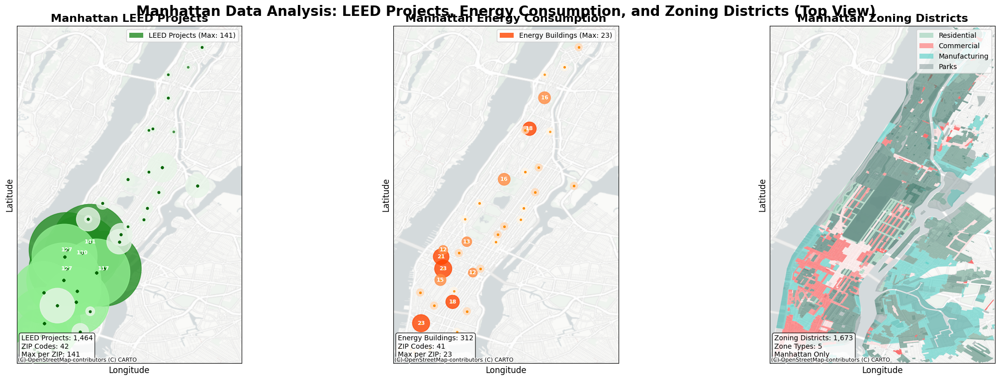


✅ Three-panel static map created successfully!
📁 Check the 'maps' folder for:
   • manhattan_three_panel_static_bw.png (High quality)
   • manhattan_three_panel_static_bw.pdf (Vector format)

📊 The three panels show (top view):
   🏗️ Panel 1: LEED Projects (Green circles)
   ⚡ Panel 2: Energy Consumption (Orange circles)
   🏗️ Panel 3: Zoning Districts (Color-coded zones)
   🖤 Base maps: Black and white line-based


In [ ]:
# Three Panel Static Map Generator - Black & White Top View
# Creates three side-by-side maps with black and white line-based base maps

import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import contextily as ctx
from matplotlib.colors import LinearSegmentedColormap
import os


def load_and_validate_data():
    """Load and validate all datasets"""

    print("=== LOADING AND VALIDATING DATA ===")
    print("=" * 40)

    data_loaded = {}

    # Load LEED data
    try:
        leed_df = pd.read_csv("data/leed_manhattan_projects.csv")
        leed_df["Zipcode"] = leed_df["Zipcode"].astype(str)
        data_loaded["leed"] = leed_df
        print(f"✅ Loaded {len(leed_df)} Manhattan LEED projects")
    except Exception as e:
        print(f"❌ Error loading LEED data: {e}")
        return None

    # Load energy data
    try:
        energy_df = pd.read_csv("data/nyc_building_energy_data.csv")
        manhattan_energy = energy_df[
            energy_df["borough"].str.contains("MANHATTAN", case=False, na=False)
        ]
        data_loaded["energy"] = manhattan_energy
        print(f"✅ Loaded {len(manhattan_energy)} Manhattan energy records")
    except Exception as e:
        print(f"❌ Error loading energy data: {e}")
        return None

    # Load zoning data
    try:
        zoning_gdf = gpd.read_file("data/manhattan_zoning_nyzd.geojson")
        data_loaded["zoning"] = zoning_gdf
        print(f"✅ Loaded {len(zoning_gdf)} Manhattan zoning districts")
    except Exception as e:
        print(f"❌ Error loading zoning data: {e}")
        return None

    return data_loaded


def get_manhattan_zip_coordinates():
    """Get Manhattan ZIP code coordinates"""

    return {
        "10001": [40.7505, -73.9934],
        "10002": [40.7168, -73.9861],
        "10003": [40.7328, -73.9884],
        "10004": [40.6892, -74.0144],
        "10005": [40.7060, -74.0088],
        "10006": [40.7075, -74.0107],
        "10007": [40.7146, -74.0068],
        "10009": [40.7278, -73.9808],
        "10010": [40.7386, -73.9877],
        "10011": [40.7445, -73.9949],
        "10012": [40.7308, -73.9983],
        "10013": [40.7214, -74.0052],
        "10014": [40.7378, -74.0057],
        "10016": [40.7484, -73.9776],
        "10017": [40.7505, -73.9736],
        "10018": [40.7569, -73.9945],
        "10019": [40.7649, -73.9808],
        "10021": [40.7687, -73.9644],
        "10022": [40.7589, -73.9851],
        "10023": [40.7769, -73.9819],
        "10024": [40.7855, -73.9742],
        "10025": [40.7982, -73.9609],
        "10026": [40.8021, -73.9497],
        "10027": [40.8045, -73.9425],
        "10028": [40.7767, -73.9522],
        "10029": [40.7913, -73.9444],
        "10030": [40.8245, -73.9497],
        "10031": [40.8252, -73.9474],
        "10032": [40.8417, -73.9394],
        "10033": [40.8540, -73.9394],
        "10034": [40.8687, -73.9212],
        "10035": [40.7947, -73.9237],
        "10036": [40.7605, -73.9934],
        "10037": [40.8237, -73.9364],
        "10038": [40.7075, -74.0007],
        "10039": [40.8237, -73.9364],
        "10040": [40.8580, -73.9288],
        "10065": [40.7649, -73.9654],
        "10069": [40.7769, -73.9819],
        "10075": [40.7731, -73.9609],
        "10128": [40.7829, -73.9505],
        "10280": [40.7081, -74.0167],
        "10282": [40.7081, -74.0167],
    }


def create_leed_panel(ax, leed_df, zip_coordinates):
    """Create LEED projects panel with top view"""

    print("🏗️ Creating LEED projects panel (top view)...")

    # Count LEED projects by ZIP code
    leed_zip_counts = leed_df["Zipcode"].value_counts()
    max_leed_count = leed_zip_counts.max()

    # Color scheme for LEED projects (green gradient)
    leed_colors = ["#e8f5e8", "#90EE90", "#32CD32", "#228B22"]
    leed_cmap = LinearSegmentedColormap.from_list("leed_gradient", leed_colors, N=4)

    # Plot LEED project density circles
    for zipcode, count in leed_zip_counts.items():
        if zipcode in zip_coordinates:
            lat, lon = zip_coordinates[zipcode]

            # Normalize count for colormap
            normalized_count = count / max_leed_count if max_leed_count > 0 else 0
            color = leed_cmap(normalized_count)

            # Size based on count
            size = max(20, min(200, count * 3))

            # Plot circle
            circle = plt.Circle(
                (lon, lat),
                size / 10000,
                color=color,
                alpha=0.8,
                edgecolor="darkgreen",
                linewidth=1,
            )
            ax.add_patch(circle)

            # Add text for high-density areas
            if count >= max_leed_count * 0.5:
                ax.text(
                    lon,
                    lat,
                    str(count),
                    ha="center",
                    va="center",
                    fontsize=8,
                    fontweight="bold",
                    color="white",
                )

    # Add individual LEED project points
    for idx, row in leed_df.iterrows():
        zipcode = row["Zipcode"]
        if zipcode in zip_coordinates:
            lat, lon = zip_coordinates[zipcode]
            ax.scatter(lon, lat, c="darkgreen", s=8, alpha=0.6, marker="o")

    # Set up the panel (top view)
    ax.set_xlim(-74.02, -73.90)
    ax.set_ylim(40.70, 40.88)
    ax.set_title("Manhattan LEED Projects", fontsize=16, fontweight="bold")
    ax.set_xlabel("Longitude", fontsize=12)
    ax.set_ylabel("Latitude", fontsize=12)
    ax.set_xticks([])
    ax.set_yticks([])
    # Ensure top view perspective
    ax.set_aspect("equal")

    # Add legend
    leed_legend_elements = [
        plt.Circle(
            (0, 0),
            0.5,
            facecolor="#228B22",
            alpha=0.8,
            label=f"LEED Projects (Max: {max_leed_count})",
        )
    ]
    ax.legend(handles=leed_legend_elements, loc="upper right")

    # Add statistics
    leed_stats = f"LEED Projects: {len(leed_df):,}\nZIP Codes: {len(leed_zip_counts)}\nMax per ZIP: {max_leed_count}"
    ax.text(
        0.02,
        0.02,
        leed_stats,
        transform=ax.transAxes,
        fontsize=10,
        bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8),
    )

    return max_leed_count


def create_energy_panel(ax, energy_df, zip_coordinates):
    """Create energy consumption panel with top view"""

    print("⚡ Creating energy consumption panel (top view)...")

    # Process energy data by ZIP code
    energy_zip_counts = energy_df["postal_code"].value_counts()
    max_energy_count = energy_zip_counts.max()

    # Color scheme for energy consumption (orange/red gradient)
    energy_colors = ["#fff5e6", "#ffdab9", "#ff8c42", "#ff4500"]
    energy_cmap = LinearSegmentedColormap.from_list(
        "energy_gradient", energy_colors, N=4
    )

    # Plot energy consumption density circles
    for zipcode, count in energy_zip_counts.items():
        if str(zipcode) in zip_coordinates:
            lat, lon = zip_coordinates[str(zipcode)]

            # Normalize count for colormap
            normalized_count = count / max_energy_count if max_energy_count > 0 else 0
            color = energy_cmap(normalized_count)

            # Size based on count
            size = max(20, min(200, count * 2))

            # Plot circle
            circle = plt.Circle(
                (lon, lat),
                size / 10000,
                color=color,
                alpha=0.8,
                edgecolor="darkorange",
                linewidth=1,
            )
            ax.add_patch(circle)

            # Add text for high-density areas
            if count >= max_energy_count * 0.5:
                ax.text(
                    lon,
                    lat,
                    str(count),
                    ha="center",
                    va="center",
                    fontsize=8,
                    fontweight="bold",
                    color="white",
                )

    # Add individual energy building points
    for idx, row in energy_df.iterrows():
        zipcode = str(row["postal_code"])
        if zipcode in zip_coordinates:
            lat, lon = zip_coordinates[zipcode]
            ax.scatter(lon, lat, c="darkorange", s=6, alpha=0.5, marker="o")

    # Set up the panel (top view)
    ax.set_xlim(-74.02, -73.90)
    ax.set_ylim(40.70, 40.88)
    ax.set_title("Manhattan Energy Consumption", fontsize=16, fontweight="bold")
    ax.set_xlabel("Longitude", fontsize=12)
    ax.set_ylabel("Latitude", fontsize=12)
    ax.set_xticks([])
    ax.set_yticks([])
    # Ensure top view perspective
    ax.set_aspect("equal")

    # Add legend
    energy_legend_elements = [
        plt.Circle(
            (0, 0),
            0.5,
            facecolor="#ff4500",
            alpha=0.8,
            label=f"Energy Buildings (Max: {max_energy_count})",
        )
    ]
    ax.legend(handles=energy_legend_elements, loc="upper right")

    # Add statistics
    energy_stats = f"Energy Buildings: {len(energy_df):,}\nZIP Codes: {len(energy_zip_counts)}\nMax per ZIP: {max_energy_count}"
    ax.text(
        0.02,
        0.02,
        energy_stats,
        transform=ax.transAxes,
        fontsize=10,
        bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8),
    )

    return max_energy_count


def create_zoning_panel(ax, zoning_gdf):
    """Create zoning districts panel with top view"""

    print("🏗️ Creating zoning districts panel (top view)...")

    # Color scheme for zone types
    zone_colors = {
        # Residential zones (Green shades)
        "R1": "#96CEB4",
        "R2": "#88C0A8",
        "R3": "#7AB29C",
        "R4": "#6CA490",
        "R5": "#5E9684",
        "R6": "#508878",
        "R7": "#427A6C",
        "R8": "#346C60",
        "R9": "#265E54",
        "R10": "#185048",
        # Commercial zones (Red shades)
        "C1": "#FF6B6B",
        "C2": "#FF8E8E",
        "C3": "#FFB3B3",
        "C4": "#FFD9D9",
        "C5": "#FFE6E6",
        "C6": "#FF4D4D",
        "C7": "#FF3333",
        "C8": "#FF1A1A",
        # Manufacturing zones (Teal shades)
        "M1": "#4ECDC4",
        "M2": "#45B7AF",
        "M3": "#3CA19A",
        # Special districts (Purple shades)
        "SD": "#9B59B6",
        "SP": "#8E44AD",
        # Parks (Gray shades)
        "PARK": "#95A5A6",
        "P": "#7F8C8D",
    }

    # Track which zone types we actually have
    found_zone_types = set()

    # Plot zoning districts
    for idx, row in zoning_gdf.iterrows():
        zone_dist = row["ZONEDIST"]

        # Get color based on zone type
        color = "#CCCCCC"  # Default gray
        zone_category = "Other"

        # Determine zone category and color
        if zone_dist.startswith("R"):
            zone_category = "Residential"
            for r_zone in ["R1", "R2", "R3", "R4", "R5", "R6", "R7", "R8", "R9", "R10"]:
                if zone_dist.startswith(r_zone):
                    color = zone_colors.get(r_zone, "#96CEB4")
                    break
        elif zone_dist.startswith("C"):
            zone_category = "Commercial"
            for c_zone in ["C1", "C2", "C3", "C4", "C5", "C6", "C7", "C8"]:
                if zone_dist.startswith(c_zone):
                    color = zone_colors.get(c_zone, "#FF6B6B")
                    break
        elif zone_dist.startswith("M"):
            zone_category = "Manufacturing"
            for m_zone in ["M1", "M2", "M3"]:
                if zone_dist.startswith(m_zone):
                    color = zone_colors.get(m_zone, "#4ECDC4")
                    break
        elif zone_dist.startswith("PARK") or zone_dist == "PARK":
            zone_category = "Park"
            color = zone_colors.get("PARK", "#95A5A6")
        elif zone_dist.startswith("SD") or zone_dist.startswith("SP"):
            zone_category = "Special District"
            color = zone_colors.get("SD", "#9B59B6")

        found_zone_types.add(zone_category)

        # Plot the zoning district
        ax.fill(
            row["geometry"].exterior.xy[0],
            row["geometry"].exterior.xy[1],
            color=color,
            alpha=0.6,
            edgecolor="none",
        )

    # Set up the panel (top view)
    ax.set_xlim(-74.02, -73.90)
    ax.set_ylim(40.70, 40.88)
    ax.set_title("Manhattan Zoning Districts", fontsize=16, fontweight="bold")
    ax.set_xlabel("Longitude", fontsize=12)
    ax.set_ylabel("Latitude", fontsize=12)
    ax.set_xticks([])
    ax.set_yticks([])
    # Ensure top view perspective
    ax.set_aspect("equal")

    # Add legend
    zoning_legend_elements = []
    if "Residential" in found_zone_types:
        zoning_legend_elements.append(
            plt.Rectangle(
                (0, 0), 1, 1, facecolor="#96CEB4", alpha=0.6, label="Residential"
            )
        )
    if "Commercial" in found_zone_types:
        zoning_legend_elements.append(
            plt.Rectangle(
                (0, 0), 1, 1, facecolor="#FF6B6B", alpha=0.6, label="Commercial"
            )
        )
    if "Manufacturing" in found_zone_types:
        zoning_legend_elements.append(
            plt.Rectangle(
                (0, 0), 1, 1, facecolor="#4ECDC4", alpha=0.6, label="Manufacturing"
            )
        )
    if "Special District" in found_zone_types:
        zoning_legend_elements.append(
            plt.Rectangle(
                (0, 0), 1, 1, facecolor="#9B59B6", alpha=0.6, label="Special Districts"
            )
        )
    if "Park" in found_zone_types:
        zoning_legend_elements.append(
            plt.Rectangle((0, 0), 1, 1, facecolor="#95A5A6", alpha=0.6, label="Parks")
        )

    ax.legend(handles=zoning_legend_elements, loc="upper right")

    # Add statistics
    zoning_stats = f"Zoning Districts: {len(zoning_gdf):,}\nZone Types: {len(found_zone_types)}\nManhattan Only"
    ax.text(
        0.02,
        0.02,
        zoning_stats,
        transform=ax.transAxes,
        fontsize=10,
        bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8),
    )

    return len(found_zone_types)


def create_three_panel_map():
    """Create three side-by-side static maps with black and white base maps"""

    print("=== CREATING THREE PANEL STATIC MAP (TOP VIEW) ===")
    print("=" * 55)

    # Load and validate data
    data = load_and_validate_data()
    if data is None:
        print("❌ Failed to load data")
        return None

    leed_df = data["leed"]
    energy_df = data["energy"]
    zoning_gdf = data["zoning"]

    # Get Manhattan ZIP coordinates
    zip_coordinates = get_manhattan_zip_coordinates()

    # Create the figure with three subplots
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 8))

    # Set the main title
    fig.suptitle(
        "Manhattan Data Analysis: LEED Projects, Energy Consumption, and Zoning Districts (Top View)",
        fontsize=20,
        fontweight="bold",
        y=0.95,
    )

    # Create each panel
    max_leed_count = create_leed_panel(ax1, leed_df, zip_coordinates)
    max_energy_count = create_energy_panel(ax2, energy_df, zip_coordinates)
    zone_types_count = create_zoning_panel(ax3, zoning_gdf)

    # Add black and white line-based basemaps to all panels
    try:
        for ax in [ax1, ax2, ax3]:
            ctx.add_basemap(
                ax,
                crs=zoning_gdf.crs.to_string(),
                source=ctx.providers.CartoDB.PositronNoLabels,
            )
        print("✅ Added black and white line-based basemaps to all panels")
    except Exception as e:
        print(f"⚠️ Could not add basemaps: {e}")

    # Adjust layout
    plt.tight_layout()

    # Save the three-panel map
    map_file = "maps/manhattan_three_panel_static_bw.png"
    plt.savefig(map_file, dpi=300, bbox_inches="tight", facecolor="white")
    print(f"✅ Three-panel Manhattan map saved as: {map_file}")

    # Also save as PDF for high quality
    pdf_file = "maps/manhattan_three_panel_static_bw.pdf"
    plt.savefig(pdf_file, bbox_inches="tight", facecolor="white")
    print(f"✅ Three-panel Manhattan map saved as: {pdf_file}")

    # Display summary statistics
    print(f"\n📊 THREE PANEL MAP SUMMARY (TOP VIEW):")
    print(
        f"   🏗️ LEED Projects: {len(leed_df):,} projects (Max per ZIP: {max_leed_count})"
    )
    print(
        f"   ⚡ Energy Buildings: {len(energy_df):,} buildings (Max per ZIP: {max_energy_count})"
    )
    print(
        f"   🏗️ Zoning Districts: {len(zoning_gdf):,} districts ({zone_types_count} zone types)"
    )

    # Show the plot
    plt.show()

    return fig


def main():
    """Main function to create three-panel static map with top view"""

    print("🗽 Creating three-panel Manhattan static map (top view)...")

    # Create the three-panel map
    fig = create_three_panel_map()

    if fig:
        print("\n✅ Three-panel static map created successfully!")
        print("📁 Check the 'maps' folder for:")
        print("   • manhattan_three_panel_static_bw.png (High quality)")
        print("   • manhattan_three_panel_static_bw.pdf (Vector format)")
        print("\n📊 The three panels show (top view):")
        print("   🏗️ Panel 1: LEED Projects (Green circles)")
        print("   ⚡ Panel 2: Energy Consumption (Orange circles)")
        print("   🏗️ Panel 3: Zoning Districts (Color-coded zones)")
        print("   🖤 Base maps: Black and white line-based")
    else:
        print("\n❌ Could not create three-panel map")


if __name__ == "__main__":
    main()

SECTION 5: My Conclusion

Based on my observations, buildings in Midtown and Lower Manhattan, particularly in the Financial District, show higher energy consumption. Most of the high-usage areas are concentrated in commercial zones. While Midtown has a notable cluster of LEED-certified buildings, Lower Manhattan still has significant potential for futher sustainable development.
Future steps could include incorporating other sustainability certification benchmarks in addition to LEED to provide a more complete analysis.